In [209]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import numpy as np
import pandas as pd
import datetime
import numpy as np
import pandas as pd
import datetime
from math import sqrt
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error


In [210]:
pwd

'/home/bharat/proj/hackathon/ndata'

In [211]:
from statsmodels.tsa.api import ExponentialSmoothing, SimpleExpSmoothing, Holt
import statsmodels.api as sm

In [212]:
data = pd.read_csv("Invmovements.csv",sep = ",")

In [213]:
data.head()

,Plant,PostingDate,StorageLocation,MaterialDocument,MaterialDocumentItem,MaterialNumber_MARC,MaterialDescription,MovementType,MovementTypeText,DebitCreditInd,Quantity_SUM,MaterialDocument_COUNT
0,C002,20140605,30,5000013315,1,150000013,CHANGER 5 TUBE-FR,101,GR goods receipt,S,37.0,1
1,C002,20140702,30,5000014438,1,150034849,DECK REFRIG ROYAL ECONO COOL-NFR,101,GR goods receipt,S,6.0,1
2,C002,20140711,30,4900171660,1,150000013,CHANGER 5 TUBE-FR,641,TF to stck in trans.,H,20.0,1
3,C002,20140722,30,5000015178,1,150000017,VALIDATOR MARS 2000 SERIES 24 V-FR,101,GR goods receipt,S,37.0,1
4,C002,20140818,30,5000016383,1,150034851,DECK REFRIG DN800-NFR,101,GR goods receipt,S,2.0,1


In [3]:
# pwd

In [4]:
data.to_csv('Inventory_main.csv',sep = "|",index = False) 

In [3]:
# exp = data.head(100)

# export_csv = exp.to_csv (r'Inventory(100).csv',sep = ",", index = None, header=True)

# data1 = pd.read_csv("Inventory(100).csv",error_bad_lines=False)

In [10]:
# data1.to_csv('Invmovements.csv') 
data1.to_csv('Invmovements.csv',sep = ",",index = False) 

In [9]:
data1 = pd.read_csv("/home/bharat/proj/hackathon/File_Invmovements_01.csv",error_bad_lines=False)

b'Skipping line 8: expected 12 fields, saw 15\nSkipping line 15: expected 12 fields, saw 13\nSkipping line 21: expected 12 fields, saw 13\nSkipping line 27: expected 12 fields, saw 15\nSkipping line 31: expected 12 fields, saw 15\nSkipping line 32: expected 12 fields, saw 15\nSkipping line 33: expected 12 fields, saw 15\nSkipping line 43: expected 12 fields, saw 15\nSkipping line 45: expected 12 fields, saw 15\nSkipping line 64: expected 12 fields, saw 13\nSkipping line 68: expected 12 fields, saw 13\nSkipping line 76: expected 12 fields, saw 13\nSkipping line 93: expected 12 fields, saw 13\nSkipping line 96: expected 12 fields, saw 13\nSkipping line 100: expected 12 fields, saw 13\nSkipping line 124: expected 12 fields, saw 13\nSkipping line 153: expected 12 fields, saw 15\nSkipping line 165: expected 12 fields, saw 13\nSkipping line 167: expected 12 fields, saw 14\nSkipping line 177: expected 12 fields, saw 14\nSkipping line 179: expected 12 fields, saw 13\nSkipping line 189: expecte

In [5]:
data = data.loc[data["StorageLocation"]<200]
data.head()

,Plant,PlantName,MaterialType,MaterialType_description,MaterialNumber,MaterialDescription,StorageLocation,PostingDate,ClosingStock_SUM_SUM
0,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170614.0,5.0
1,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170615.0,5.0
2,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170616.0,5.0
3,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170617.0,5.0
4,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170618.0,5.0


In [ ]:
df1 = data1[data1["Plant"] == "C002"]

df1.shape


In [74]:
df2 = data[data["Plant"] == "C002"]


In [63]:
df2.shape

(273559, 9)

In [86]:
df1.rename(columns = {"MaterialNumber_MARC": "MaterialNumber"}, 
                                 inplace = True) 

In [87]:
df1.head()

,Plant,PostingDate,StorageLocation,MaterialDocument,MaterialDocumentItem,MaterialNumber,MaterialDescription,MovementType,MovementTypeText,DebitCreditInd,Quantity_SUM,MaterialDocument_COUNT
0,C002,20140605,30,5000013315,1,150000013,CHANGER 5 TUBE-FR,101,GR goods receipt,S,37.0,1
1,C002,20140702,30,5000014438,1,150034849,DECK REFRIG ROYAL ECONO COOL-NFR,101,GR goods receipt,S,6.0,1
3,C002,20140722,30,5000015178,1,150000017,VALIDATOR MARS 2000 SERIES 24 V-FR,101,GR goods receipt,S,37.0,1
4,C002,20140818,30,5000016383,1,150034851,DECK REFRIG DN800-NFR,101,GR goods receipt,S,2.0,1
5,C002,20140818,30,5000016383,2,150034850,CHANGER-NFR,101,GR goods receipt,S,4.0,1


In [ ]:
# exp = df1[["MovementType","DebitCreditInd"]].groupby(["MovementType"])

In [89]:
# exp.get_group(551)

In [90]:
df2.head()

,Plant,PlantName,MaterialType,MaterialType_description,MaterialNumber,MaterialDescription,StorageLocation,PostingDate,ClosingStock_SUM_SUM
0,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170614.0,5.0
1,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170615.0,5.0
2,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170616.0,5.0
3,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170617.0,5.0
4,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170618.0,5.0


In [91]:
# df_merge = df1.merge(df2,on = ["MaterialNumber"],how = "inner")

In [92]:
# df_merge.head(20)

In [111]:
print(len(df1["MaterialNumber"].unique()))

k1 = df1["MaterialNumber"].unique()
arr1 = np.sort(k1, axis = None)         

# arr1

132


In [94]:
len(arr1)

231

In [95]:
print(len(df2["MaterialNumber"].unique()))

k2 = df2["MaterialNumber"].unique()
arr2 = np.sort(k2, axis = None)         

arr2


246


array([150000001, 150000002, 150000003, 150000004, 150000006, 150000007,
       150000008, 150000009, 150000010, 150000011, 150000012, 150000013,
       150000015, 150000016, 150000017, 150000018, 150000022, 150000023,
       150000026, 150000027, 150000028, 150000029, 150000030, 150000031,
       150000032, 150000033, 150000034, 150000036, 150000037, 150000038,
       150000039, 150000043, 150000044, 150000049, 150000050, 150000051,
       150000052, 150000053, 150000054, 150000055, 150000056, 150000263,
       150000462, 150000667, 150000669, 150000697, 150000698, 150000960,
       150002122, 150002279, 150002339, 150002377, 150002915, 150003301,
       150003627, 150003628, 150003757, 150003884, 150003970, 150004002,
       150004235, 150004516, 150004730, 150004751, 150004856, 150006080,
       150006144, 150006347, 150006532, 150006707, 150006885, 150007006,
       150007925, 150007983, 150008381, 150008445, 150008508, 150008759,
       150008784, 150009188, 150009223, 150009864, 

In [96]:
# cnt = 0
# for i in range(0,len(arr1)):
#     for j in range(0,len(arr2)):
#         if(arr1[i]==arr2[j]):
#             cnt+=1

In [97]:
# cnt

In [98]:
df2.head(1)

,Plant,PlantName,MaterialType,MaterialType_description,MaterialNumber,MaterialDescription,StorageLocation,PostingDate,ClosingStock_SUM_SUM
0,C002,"Lavergne, TN ROC",ZERS,SCL CDE Spare Parts,150000001,CHANGER 110V-FR,30,20170614.0,5.0


In [99]:
main_df2= df2[["StorageLocation","MaterialNumber","PostingDate","ClosingStock_SUM_SUM"]]
main_df2.head()

,StorageLocation,MaterialNumber,PostingDate,ClosingStock_SUM_SUM
0,30,150000001,20170614.0,5.0
1,30,150000001,20170615.0,5.0
2,30,150000001,20170616.0,5.0
3,30,150000001,20170617.0,5.0
4,30,150000001,20170618.0,5.0


In [100]:
df1 = df1[df1.MovementType.isin([101, 102, 261, 262, 551])]
df1.head()

,Plant,PostingDate,StorageLocation,MaterialDocument,MaterialDocumentItem,MaterialNumber,MaterialDescription,MovementType,MovementTypeText,DebitCreditInd,Quantity_SUM,MaterialDocument_COUNT
0,C002,20140605,30,5000013315,1,150000013,CHANGER 5 TUBE-FR,101,GR goods receipt,S,37.0,1
1,C002,20140702,30,5000014438,1,150034849,DECK REFRIG ROYAL ECONO COOL-NFR,101,GR goods receipt,S,6.0,1
3,C002,20140722,30,5000015178,1,150000017,VALIDATOR MARS 2000 SERIES 24 V-FR,101,GR goods receipt,S,37.0,1
4,C002,20140818,30,5000016383,1,150034851,DECK REFRIG DN800-NFR,101,GR goods receipt,S,2.0,1
5,C002,20140818,30,5000016383,2,150034850,CHANGER-NFR,101,GR goods receipt,S,4.0,1


In [102]:
main_df1  = df1[["PostingDate","StorageLocation","MaterialNumber","MovementType","Quantity_SUM"]]

In [103]:
main_df1.head()

,PostingDate,StorageLocation,MaterialNumber,MovementType,Quantity_SUM
0,20140605,30,150000013,101,37.0
1,20140702,30,150034849,101,6.0
3,20140722,30,150000017,101,37.0
4,20140818,30,150034851,101,2.0
5,20140818,30,150034850,101,4.0


In [81]:
# df1[df1["MaterialNumber_MARC"] == 150000013 ]

In [48]:
main_df2.PostingDate = main_df2.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))

In [49]:
main_df2.shape

(273559, 4)

In [51]:
grouped = main_df2.groupby(["MaterialNumber","StorageLocation"])


In [52]:
"/home/bharat/proj/hackathon/graphs/Inventory"

'/home/bharat/proj/hackathon/graphs/Inventory'

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


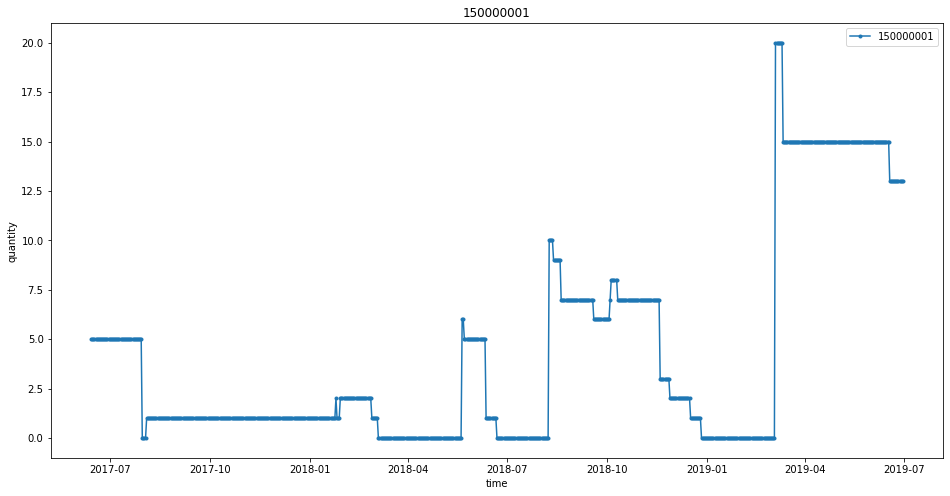

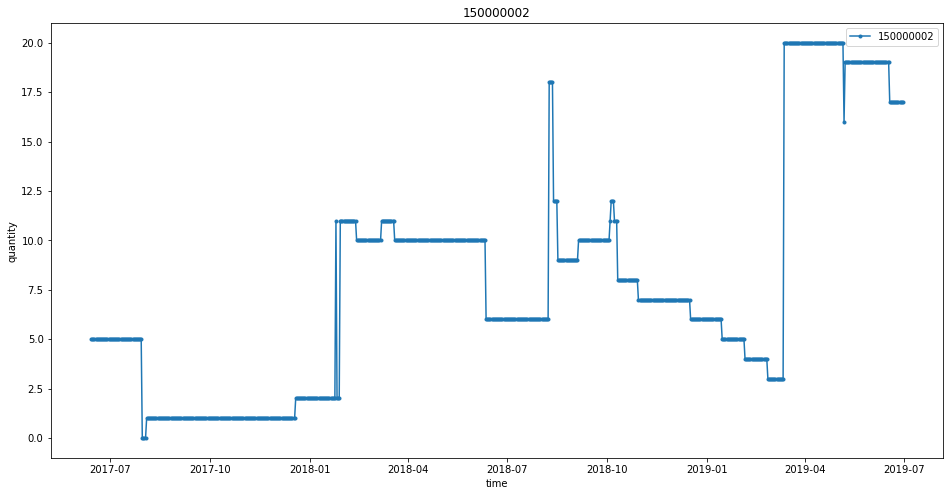

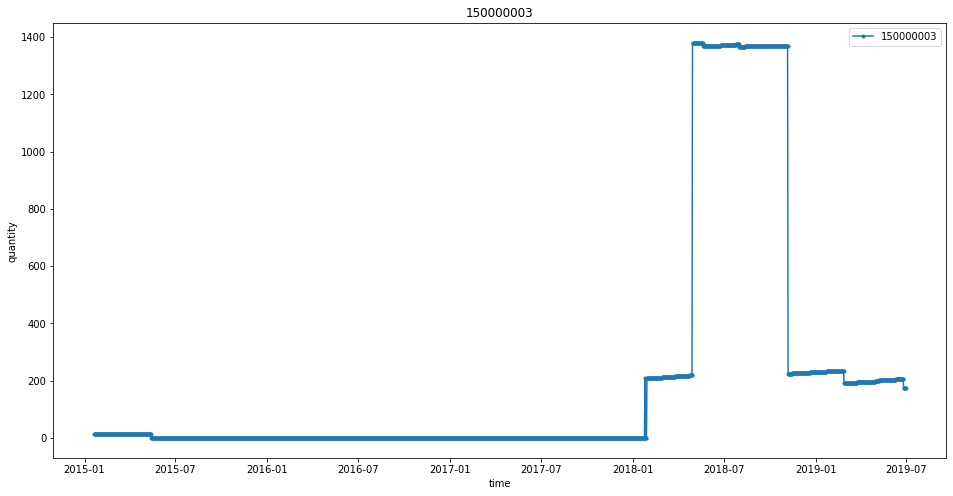

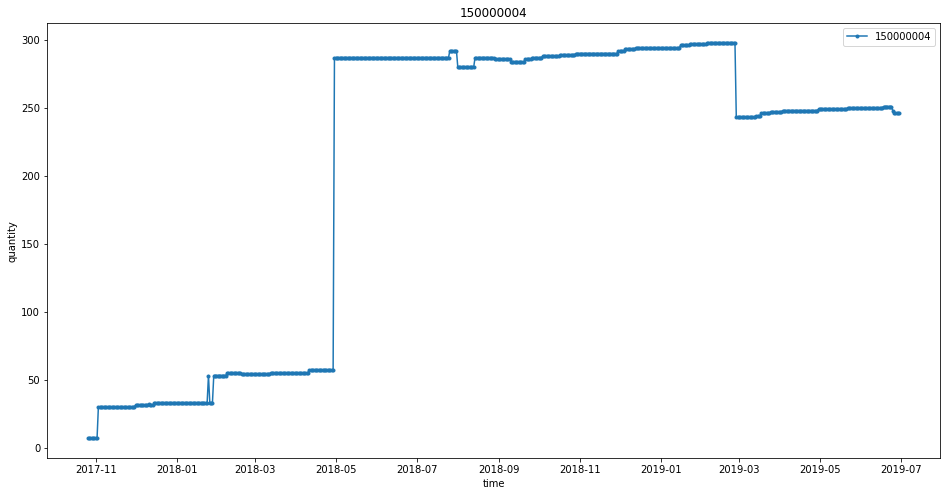

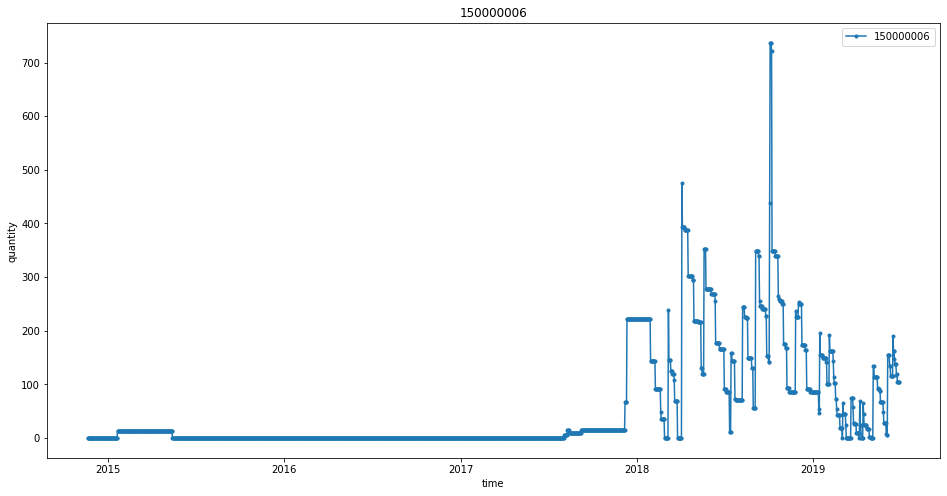

...

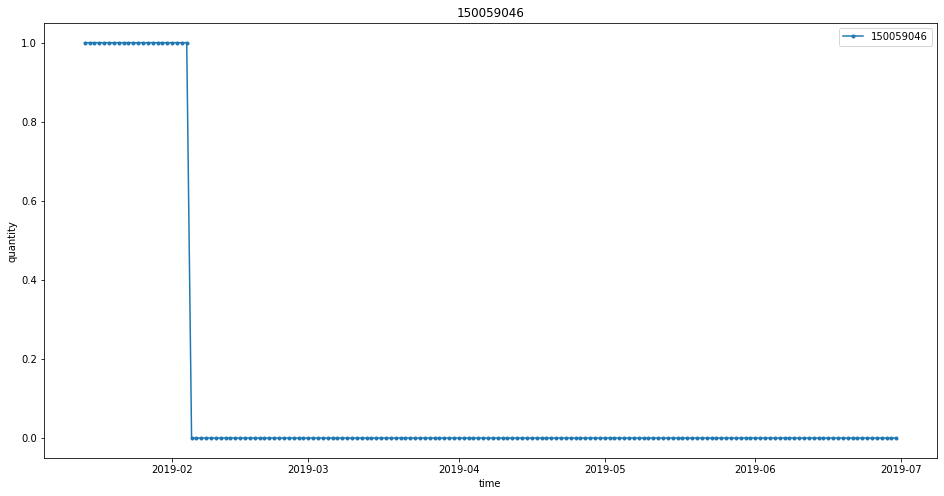

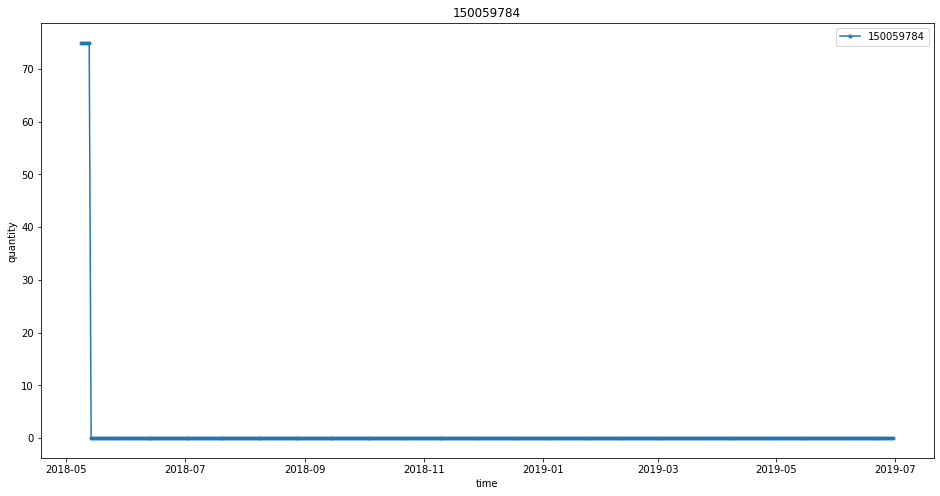

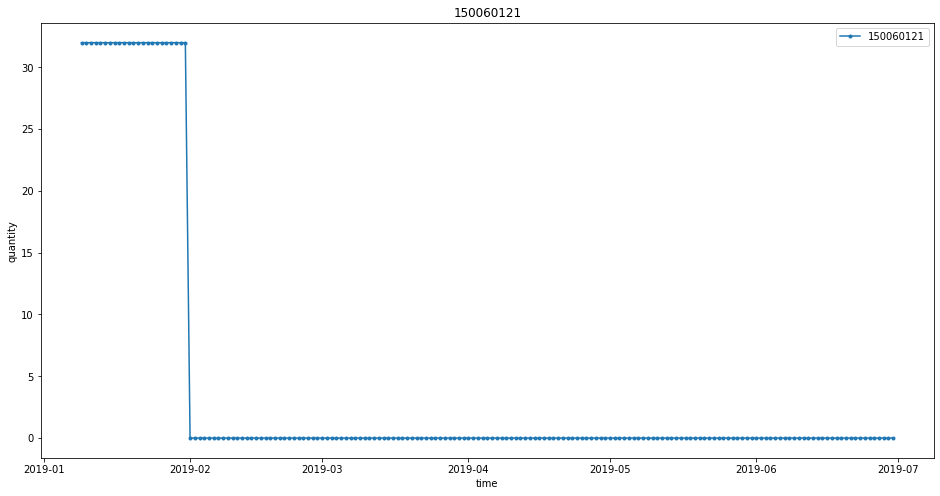

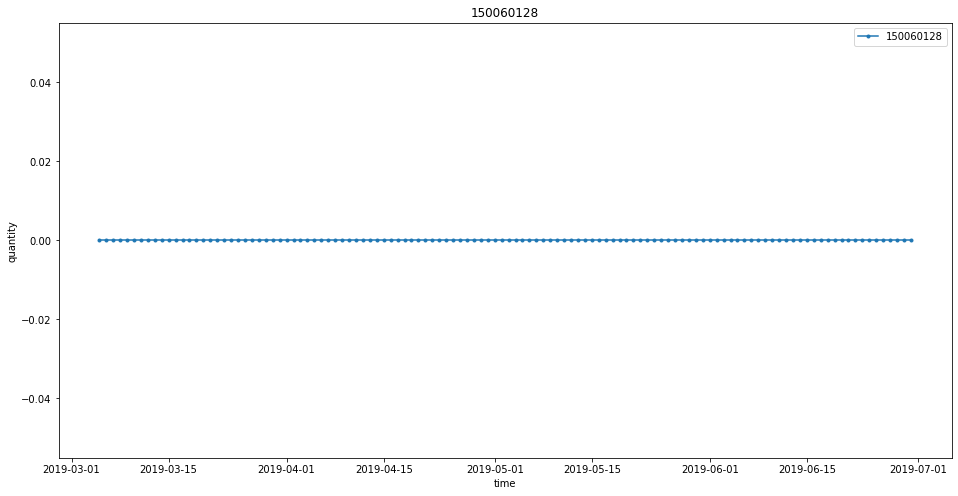

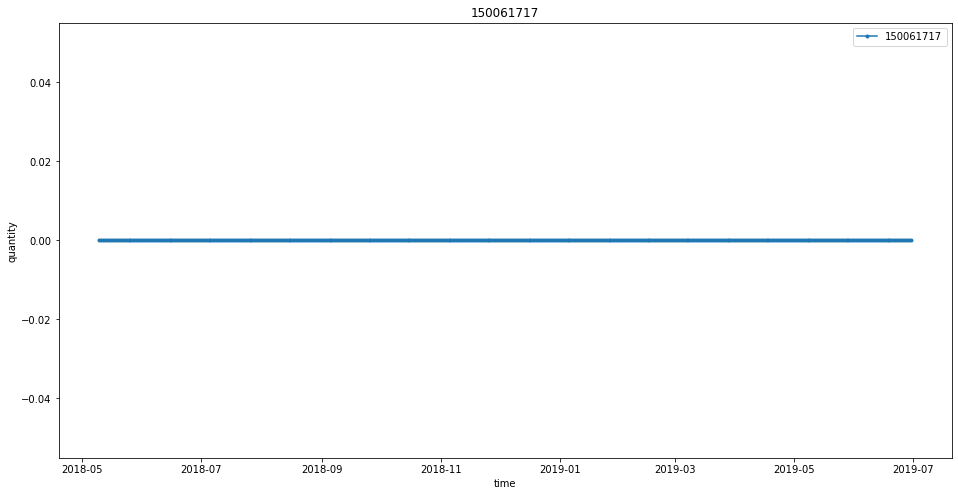

In [54]:
for i in range(0,200):
    try:        
        group = grouped.get_group((arr1[i],30))
        plt.figure(figsize=(16,8))
        plt.plot( group.set_index(["PostingDate"])["ClosingStock_SUM_SUM"], marker='.', label=arr1[i])
        plt.title(arr1[i])
        plt.xlabel("time")
        plt.ylabel('quantity')
        plt.legend()
        plt.savefig("/home/bharat/proj/hackathon/graphs/Inventory/C002/" + 'Graph_{}.png'.format(arr1[i]), format="PNG")  
        plt.close(plt)    # close the figure
    except:
            pass  


In [71]:
# data.sort_values(["MaterialDocument", "MaterialNumber_MARC"])

In [72]:
# df = data.loc[data["StorageLocation"]<200]

In [73]:
data.shape

(14814160, 9)

In [74]:
data.columns

Index(['Plant', 'PlantName', 'MaterialType', 'MaterialType_description',
       'MaterialNumber', 'MaterialDescription', 'StorageLocation',
       'PostingDate', 'ClosingStock_SUM_SUM'],
      dtype='object')

In [75]:
data["Plant"].unique()

array(['C002', 'C004'], dtype=object)

In [76]:
len(data["PostingDate"].unique())

1778

In [77]:
data["PostingDate"].min(), data["PostingDate"].max()

(20140818.0, 20190630.0)

In [78]:
data["PostingDate"].sort_values().head()

201980    20140818.0
203758    20140818.0
226413    20140818.0
214623    20140818.0
34534     20140818.0
Name: PostingDate, dtype: float64

In [35]:
data["PostingDate"].value_counts().head()

0.0           17958
20190630.0    12408
20190629.0    12408
20190628.0    12407
20190627.0    12404
Name: PostingDate, dtype: int64

### 1. StorageLocation

In [79]:
data["StorageLocation"].unique()

array([ 30,  35, 103, 109, 105, 110, 104, 108, 101, 102, 107, 106])

In [80]:
len(data["StorageLocation"].unique())

12

### 2. PlantName

In [81]:
len(data["PlantName"].unique())

2

In [82]:
data["PlantName"].unique()

array(['Lavergne, TN ROC', 'Knoxville, TN'], dtype=object)

### 3. MaterialType

In [83]:
len(data["MaterialType"].unique())

1

In [84]:
k = data["MaterialType"].unique()

In [85]:
arr1 = np.sort(k, axis = None)         

arr1

array(['ZERS'], dtype=object)

### 4. MaterialType_description

In [86]:
len(data["MaterialType_description"].unique())

1

In [87]:
data["MaterialType_description"].unique()

array(['SCL CDE Spare Parts'], dtype=object)

### 5. MaterialNumber

In [90]:
len(data["MaterialNumber"].unique())

3490

In [91]:
data["MaterialNumber"].count()

14814160

In [60]:
data["MaterialNumber"].value_counts()

150000013    21119
150000017    21119
150000026    19949
150000034    19848
150004856    19193
150000027    19120
150000038    18886
150011382    18821
150017195    18821
150033522    18811
150000028    18810
150017194    18810
150007092    18808
150004720    18807
150033199    18745
150028459    18681
150028383    18667
150027005    18584
150003220    18534
150013771    18466
150035207    18458
150008325    18429
150033850    18418
150000056    18409
150035217    18396
150031471    18349
150004713    18302
150017192    18292
150033906    18291
150003747    18277
             ...  
150035161       38
150035757       38
150078564       36
150074330       33
150074287       29
150028897       28
150029577       28
150010314       28
150009299       21
150011892       21
150020159       20
150061756       18
150019315       18
150079247       18
150008173       17
150079643       17
150030604       17
150070830       17
150001612       17
150019309       17
150003022       17
150003023   

### 6. ClosingStock_SUM_SUM

In [61]:
len(data["ClosingStock_SUM_SUM"].unique())

1895

In [62]:
data["ClosingStock_SUM_SUM"].unique()

array([  5.,   0.,   1., ..., 996., 991., 985.])

In [104]:
# data["ClosingStock_SUM_SUM"].value_counts()

In [27]:
# data.groupby("MovementType").count()

In [28]:
df1 = data[data["Plant"] == "C002"]

print(df1.shape)

print(df1["MovementType"].value_counts().sum())

df1["MovementType"].value_counts()

(6938, 12)
6938


101    1932
351    1643
301     884
311     816
302     627
309     296
262     165
641     144
261     117
702      80
551      77
701      65
561      48
312      27
310      11
102       5
642       1
Name: MovementType, dtype: int64

In [29]:
df2 = data[data["Plant"] == "C004"]

print(df2.shape)

print(df2["MovementType"].value_counts().sum())

df2["MovementType"].value_counts()

(136844, 12)
136844


261    73223
101    25603
313    17628
315     7637
561     4572
262     2571
311     1525
702     1458
701      887
551      566
301      451
641      292
351      165
302       84
309       75
122       40
102       19
552       14
352       13
562        8
642        8
161        4
123        1
Name: MovementType, dtype: int64

### 7. MovementTypeText

In [30]:
len(data["MovementTypeText"].unique())

23

In [31]:
data["MovementTypeText"].unique()

array(['GR goods receipt', 'TF to stck in trans.', 'TF tfr ps.mat.to mat',
       'GR phys.inv.: whse', 'GI phys.inv.: whse', 'RE for order',
       'TF trfr within plant', 'GI for order', 'GI scrapping',
       'TF trfr plnt to plnt', 'TR trfr plnt to plnt',
       'TR to stck in trans.', 'Initial stock entry',
       'TR transfer in plant', 'GR for PO   reversal',
       'TR tfr ps.mat.to mat', 'TF rem.fm str.toSLoc',
       'TF pl.in str.in SLoc', 'RE return to vendor',
       'RE in.entry stk bals', 'GR returns', 'RE scrapping',
       'RE rtrn vendor rev.'], dtype=object)

In [32]:
df3 = data[data["Plant"] == "C002"]

print(df3.shape)

print(df3["MovementTypeText"].value_counts().sum())

df3["MovementTypeText"].value_counts()

(6938, 12)
6938


GR goods receipt        1932
TF to stck in trans.    1787
TF trfr plnt to plnt     884
TF trfr within plant     816
TR trfr plnt to plnt     627
TF tfr ps.mat.to mat     296
RE for order             165
GI for order             117
GI phys.inv.: whse        80
GI scrapping              77
GR phys.inv.: whse        65
Initial stock entry       48
TR transfer in plant      27
TR tfr ps.mat.to mat      11
GR for PO   reversal       5
TR to stck in trans.       1
Name: MovementTypeText, dtype: int64

In [33]:
df4 = data[data["Plant"] == "C004"]

print(df4.shape)

print(df4["MovementTypeText"].value_counts().sum())

df4["MovementTypeText"].value_counts()

(136844, 12)
136844


GI for order            73223
GR goods receipt        25603
TF rem.fm str.toSLoc    17628
TF pl.in str.in SLoc     7637
Initial stock entry      4572
RE for order             2571
TF trfr within plant     1525
GI phys.inv.: whse       1458
GR phys.inv.: whse        887
GI scrapping              566
TF to stck in trans.      457
TF trfr plnt to plnt      451
TR trfr plnt to plnt       84
TF tfr ps.mat.to mat       75
RE return to vendor        40
TR to stck in trans.       21
GR for PO   reversal       19
RE scrapping               14
RE in.entry stk bals        8
GR returns                  4
RE rtrn vendor rev.         1
Name: MovementTypeText, dtype: int64

In [34]:
data[["MovementType", "MovementTypeText"]].drop_duplicates()

,MovementType,MovementTypeText
0,101,GR goods receipt
2,641,TF to stck in trans.
21,309,TF tfr ps.mat.to mat
41,701,GR phys.inv.: whse
54,702,GI phys.inv.: whse
68,262,RE for order
74,311,TF trfr within plant
97,261,GI for order
163,551,GI scrapping
278,301,TF trfr plnt to plnt


### 8. DebitCreditInd

In [35]:
data["DebitCreditInd"].unique()

array(['S', 'H'], dtype=object)

### 9. Quantity_SUM

In [36]:
len(data["Quantity_SUM"].unique())

323

In [37]:
l = data["Quantity_SUM"].unique()
arr = np.median(l,axis = None)
arr

188.0

### 10. MaterialDocument_COUNT

In [38]:
data["MaterialDocument_COUNT"].unique()

array([1])

In [39]:
# data[["MaterialNumber_MARC", "MaterialDescription"]].drop_duplicates()

In [40]:
a = data[["MaterialNumber_MARC","MaterialDescription"]].groupby('MaterialNumber_MARC').count().reset_index()["MaterialDescription"].value_counts()

In [41]:
import matplotlib.pyplot as plt

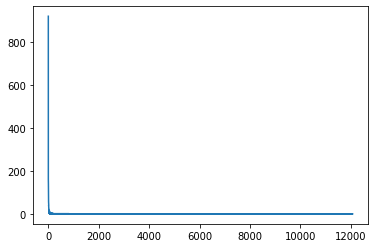

In [42]:
plt.plot(a)

In [43]:
b = data[["MaterialNumber_MARC","MaterialDescription"]].groupby('MaterialNumber_MARC')

In [44]:
# b.get_group(150034849)

In [45]:
(data[["MaterialNumber_MARC","MaterialDescription"]].groupby('MaterialNumber_MARC').nunique()).head()

,MaterialNumber_MARC,MaterialDescription
MaterialNumber_MARC,,
150000001,1,1
150000002,1,1
150000003,1,1
150000004,1,1
150000005,1,1


In [46]:
c = data[["MaterialNumber_MARC","MaterialDescription"]].groupby('MaterialDescription')

In [47]:
# (data[["MaterialNumber_MARC","MaterialDescription"]].groupby('MaterialDescription').count())

In [48]:
df1 = data[data["Plant"] == "C004"]

df.shape

df["MovementType"].value_counts().sum()

df["MovementType"].value_counts()

NameError: name 'df' is not defined

In [108]:
print(main_df1.shape)
main_df1.head()

(2296, 5)


,PostingDate,StorageLocation,MaterialNumber,MovementType,Quantity_SUM
0,20140605,30,150000013,101,37.0
1,20140702,30,150034849,101,6.0
3,20140722,30,150000017,101,37.0
4,20140818,30,150034851,101,2.0
5,20140818,30,150034850,101,4.0


In [129]:
main_df1.StorageLocation.value_counts()

30     2292
102       4
Name: StorageLocation, dtype: int64

In [109]:
print(main_df2.shape)
main_df2.head()

(273559, 4)


,StorageLocation,MaterialNumber,PostingDate,ClosingStock_SUM_SUM
0,30,150000001,20170614.0,5.0
1,30,150000001,20170615.0,5.0
2,30,150000001,20170616.0,5.0
3,30,150000001,20170617.0,5.0
4,30,150000001,20170618.0,5.0


In [138]:
# main_df2[main_df2["MaterialNumber"] == 150000004 ]

In [128]:
main_df2.StorageLocation.value_counts()

30    249072
35     24487
Name: StorageLocation, dtype: int64

In [120]:
df_merge = main_df1.merge(main_df2,on = ["MaterialNumber","StorageLocation","PostingDate"],how = "inner")

# pd.merge(main_df1, main_df2, on=["MaterialNumber","StorageLocation","PostingDate"])

df_merge.shape

df_merge.head()

df_merge.StorageLocation.value_counts()

df_merge.MovementType.value_counts()

In [139]:
# cnt = 0
# for index,group in df_merge.groupby(["MaterialNumber"]):
#     plt.figure(figsize=(16,8))
#     print(index)
#     for index2,group2 in group.groupby(["MovementType"]):
# #         print(index2)  
#         print()
#         plt.plot( group2.set_index(["PostingDate"])["Quantity_SUM"], marker='.', label=index2)
#         plt.plot( group2.set_index(["PostingDate"])["ClosingStock_SUM_SUM"], marker='.', label="Net_Q",color = "black")

#         plt.title(index)
#     plt.xlabel("time")
#     plt.ylabel('quantity')
#     plt.legend()
#     plt.show()
# #     plt.savefig("/home/bharat/proj/hackathon/graphs/C004/new/" + 'Graph_{}.png'.format(index), format="PNG") 

## NEW_ANALYSIS

### FOR C002

In [40]:
df_mov1 = data1[data1["Plant"] == "C002"]
df_mov1.shape

(6938, 12)

In [41]:
df_inv1 = data[data["Plant"] == "C002"]
df_inv1.shape

(273559, 9)

In [42]:
df_inv1.StorageLocation.unique()

array([30, 35])

In [43]:
df_mov1.StorageLocation.unique()

array([ 30, 103, 102,  35])

In [44]:
# df_mov1 = df_mov1[df_mov1.StorageLocation.isin([30,35])]

In [45]:
df_mov1.head()

,Plant,PostingDate,StorageLocation,MaterialDocument,MaterialDocumentItem,MaterialNumber_MARC,MaterialDescription,MovementType,MovementTypeText,DebitCreditInd,Quantity_SUM,MaterialDocument_COUNT
0,C002,20140605,30,5000013315,1,150000013,CHANGER 5 TUBE-FR,101,GR goods receipt,S,37.0,1
1,C002,20140702,30,5000014438,1,150034849,DECK REFRIG ROYAL ECONO COOL-NFR,101,GR goods receipt,S,6.0,1
2,C002,20140711,30,4900171660,1,150000013,CHANGER 5 TUBE-FR,641,TF to stck in trans.,H,20.0,1
3,C002,20140722,30,5000015178,1,150000017,VALIDATOR MARS 2000 SERIES 24 V-FR,101,GR goods receipt,S,37.0,1
4,C002,20140818,30,5000016383,1,150034851,DECK REFRIG DN800-NFR,101,GR goods receipt,S,2.0,1


In [16]:
main_df2.shape

NameError: name 'main_df2' is not defined

In [168]:
main_df2.head()
main_df2.PostingDate = main_df2.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))

/usr/local/lib/python3.6/dist-packages/pandas/core/generic.py:5096: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


In [190]:
main_df2.head()

,StorageLocation,MaterialNumber,PostingDate,ClosingStock_SUM_SUM
0,30,150000001,2017-06-14,5.0
1,30,150000001,2017-06-15,5.0
2,30,150000001,2017-06-16,5.0
3,30,150000001,2017-06-17,5.0
4,30,150000001,2017-06-18,5.0


In [191]:
grp = main_df2.groupby(["MaterialNumber","PostingDate"]).sum()

In [192]:
grp.StorageLocation.value_counts()

30    224585
65     24487
Name: StorageLocation, dtype: int64

In [193]:
grp = grp[grp["StorageLocation"]==30]

In [194]:
# grp.get_group((150000001,20170614.0))

In [195]:
del grp["StorageLocation"]

In [196]:
grp = grp.reset_index()
grp.head()

,MaterialNumber,PostingDate,ClosingStock_SUM_SUM
0,150000001,2017-06-14,5.0
1,150000001,2017-06-15,5.0
2,150000001,2017-06-16,5.0
3,150000001,2017-06-17,5.0
4,150000001,2017-06-18,5.0


In [197]:
# plt.plot(grp["ClosingStock_SUM_SUM"])

In [200]:
# cnt = 0
# for index,group in grp.groupby(["MaterialNumber"]):
#     plt.figure(figsize=(16,8))
#     print(index)
# #     plt.plot( group2.set_index(["PostingDate"])["Quantity_SUM"], marker='.', label=index2)
#     plt.plot( group.set_index(["PostingDate"])["ClosingStock_SUM_SUM"], marker='.', label="Net_Q")

#     plt.title(index)
#     plt.xlabel("time")
#     plt.ylabel('quantity')
#     plt.legend()
# #     plt.show()
#     plt.savefig("/home/bharat/proj/hackathon/graphs/Inventory/C002/" + 'Graph_{}.png'.format(index), format="PNG") 

In [201]:
main_df1.head()

,PostingDate,StorageLocation,MaterialNumber,MovementType,Quantity_SUM
0,20140605,30,150000013,101,37.0
1,20140702,30,150034849,101,6.0
3,20140722,30,150000017,101,37.0
4,20140818,30,150034851,101,2.0
5,20140818,30,150034850,101,4.0


In [205]:
main_df1.StorageLocation.unique()

array([30])

In [206]:
main_df1 = main_df1[main_df1["StorageLocation"]==30]

In [207]:
grp1 = main_df1.groupby(["MaterialNumber","MovementType","PostingDate"]).sum()

In [211]:
grp1 = grp1.reset_index()

In [213]:
grp1.head()

,MaterialNumber,MovementType,PostingDate,StorageLocation,Quantity_SUM
0,150000001,101,20170614,30,5.0
1,150000001,101,20170804,30,1.0
2,150000001,101,20171023,30,6.0
3,150000001,101,20190213,30,20.0
4,150000001,101,20190305,30,20.0


In [216]:
# cnt = 0
# for index,group in grp1.groupby(["MaterialNumber"]):
#     plt.figure(figsize=(16,8))
#     print(index)
#     for index2,group2 in group.groupby(["MovementType"]):
# #         print(index2)  
#         print()
#         plt.plot( group2.set_index(["PostingDate"])["Quantity_SUM"], marker='.', label=index2)
#         plt.title(index)
#     plt.xlabel("time")
#     plt.ylabel('quantity')
#     plt.legend()
# #     plt.show()
#     plt.savefig("/home/bharat/proj/hackathon/graphs/NC002/" + 'Graph_{}.png'.format(index), format="PNG")  


### FOR C004

In [250]:
data.shape

(143782, 12)

In [251]:
df_mov = data[data["Plant"] == "C004"]
df_mov.shape

(136844, 12)

In [252]:
data.shape

(143782, 12)

In [253]:
150000027

150000027

In [254]:
df_inv = data[data["Plant"] == "C004"]
df_inv.shape

(136844, 12)

In [255]:
# df_mov.PostingDate = df_mov.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))
df_mov.head()

,Plant,PostingDate,StorageLocation,MaterialDocument,MaterialDocumentItem,MaterialNumber_MARC,MaterialDescription,MovementType,MovementTypeText,DebitCreditInd,Quantity_SUM,MaterialDocument_COUNT
6938,C004,20141024,30,4900486738,1,150000013,CHANGER 5 TUBE-FR,561,Initial stock entry,S,39.0,1
6939,C004,20141024,30,4900486739,1,150000015,CTRL BOARD G3 ROYAL-FR,561,Initial stock entry,S,25.0,1
6940,C004,20141024,30,4900486900,1,150000017,VALIDATOR MARS 2000 SERIES 24 V-FR,561,Initial stock entry,S,74.0,1
6941,C004,20141024,30,4900486901,1,150000018,CTRL BOARD S2D DIXIE NARCO-FR,561,Initial stock entry,S,13.0,1
6942,C004,20141024,30,4900486902,1,150000288,SIGNFACE DASANI RV79W MV,561,Initial stock entry,S,1.0,1


In [256]:
# df[]

In [257]:
# df_inv = df_inv[df_inv.StorageLocation.isin([30])]
df_inv.head()

,Plant,PostingDate,StorageLocation,MaterialDocument,MaterialDocumentItem,MaterialNumber_MARC,MaterialDescription,MovementType,MovementTypeText,DebitCreditInd,Quantity_SUM,MaterialDocument_COUNT
6938,C004,20141024,30,4900486738,1,150000013,CHANGER 5 TUBE-FR,561,Initial stock entry,S,39.0,1
6939,C004,20141024,30,4900486739,1,150000015,CTRL BOARD G3 ROYAL-FR,561,Initial stock entry,S,25.0,1
6940,C004,20141024,30,4900486900,1,150000017,VALIDATOR MARS 2000 SERIES 24 V-FR,561,Initial stock entry,S,74.0,1
6941,C004,20141024,30,4900486901,1,150000018,CTRL BOARD S2D DIXIE NARCO-FR,561,Initial stock entry,S,13.0,1
6942,C004,20141024,30,4900486902,1,150000288,SIGNFACE DASANI RV79W MV,561,Initial stock entry,S,1.0,1


In [43]:
df_inv.StorageLocation.unique()

array([ 30, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110])

In [220]:
df_mov.StorageLocation.unique()

array([ 30, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110])

In [221]:
# np.sort(df_mov.Quantity_SUM.unique())

In [222]:
df_mov.MovementType.unique()

array([561, 313, 315, 261, 262, 101, 311, 701, 641, 309, 702, 122, 301,
       642, 302, 102, 562, 551, 351, 161, 552, 123, 352])

In [258]:
df_mov = df_mov[df_mov.MovementType.isin([261])]

In [224]:
# df_mov = df_mov[df_mov.MovementType.isin([101, 102,122,251, 261, 262,301,309,315,351, 551,552,561,562,701,702,310,641,642])]

In [259]:
df_mov.shape

(73223, 12)

In [260]:
df_mov.rename(columns = {"MaterialNumber_MARC": "MaterialNumber"}, 
                                 inplace = True) 
df_mov  = df_mov[["PostingDate","StorageLocation","MaterialNumber","MovementType","DebitCreditInd","Quantity_SUM"]]

df_mov.shape

(73223, 6)

In [227]:
# grp_mov['Quantity_SUM'].loc[grp_mov['MovementType'].isin([102,122,251,261,301,309,351,551,702,310,641])] = -grp_mov["Quantity_SUM"]

In [228]:
# df_mov['Quantity_SUM'].loc[df_mov['DebitCreditInd'].isin(["H"])] = -df_mov["Quantity_SUM"]
# df_mov.head()

In [229]:
grp_mov = df_mov.groupby(["MaterialNumber","MovementType","PostingDate"]).sum()

In [230]:
grp_mov = grp_mov.reset_index()
# grp_mov.head(20)

In [231]:
# cnt = 0
# for index,group in grp_mov.groupby(["MaterialNumber"]):
#     plt.figure(figsize=(16,8))
#     print(index)
#     for index2,group2 in group.groupby(["MovementType"]):
# #         print(index2)  
#         print()
#         plt.plot( group2.set_index(["PostingDate"])["Quantity_SUM"], marker='.', label=index2)
#         plt.title(index)
#     plt.xlabel("time")
#     plt.ylabel('quantity')
#     plt.legend()
# #     plt.show()
#     plt.savefig("/home/bharat/proj/hackathon/graphs/NC004/" + 'Graph_{}.png'.format(index), format="PNG")  


In [232]:
grp_mov.PostingDate = grp_mov.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))

In [233]:
# del grp_mov["StorageLocation"]

In [234]:
grp_mov.head()

,MaterialNumber,MovementType,PostingDate,StorageLocation,Quantity_SUM
0,150000005,261,2016-09-28,110,1.0
1,150000006,261,2015-03-09,110,1.0
2,150000006,261,2015-08-20,103,1.0
3,150000006,261,2015-09-10,105,1.0
4,150000006,261,2015-09-22,103,1.0


In [235]:
# grp_mov['Quantity_SUM'].loc[grp_mov['MovementType'].isin([102,122,251,261,301,309,351,551,702,310,641])] = -grp_mov["Quantity_SUM"]

In [236]:
grp_mov = grp_mov.sort_values(by = 'PostingDate')
del grp_mov["StorageLocation"]
grp_mov.head()

,MaterialNumber,MovementType,PostingDate,Quantity_SUM
19871,150026497,261,2014-10-25,12.0
13074,150017509,261,2014-10-25,1.0
34639,150032545,261,2014-10-25,1.0
41656,150033644,261,2014-10-25,1.0
36586,150033199,261,2014-10-25,2.0


In [53]:
df_inv1= df_inv1[["StorageLocation","MaterialNumber","PostingDate","ClosingStock_SUM_SUM"]]
df_inv1.head()

,StorageLocation,MaterialNumber,PostingDate,ClosingStock_SUM_SUM
0,30,150000001,20170614.0,5.0
1,30,150000001,20170615.0,5.0
2,30,150000001,20170616.0,5.0
3,30,150000001,20170617.0,5.0
4,30,150000001,20170618.0,5.0


In [54]:
df_inv1.StorageLocation.value_counts()

30    249072
35     24487
Name: StorageLocation, dtype: int64

In [55]:
grp_inv = df_inv1.groupby(["MaterialNumber","PostingDate"]).sum()

In [56]:
grp_inv = grp_inv.reset_index()
del grp_inv["StorageLocation"]
grp_inv.head()

,MaterialNumber,PostingDate,ClosingStock_SUM_SUM
0,150000001,20170614.0,5.0
1,150000001,20170615.0,5.0
2,150000001,20170616.0,5.0
3,150000001,20170617.0,5.0
4,150000001,20170618.0,5.0


In [57]:
grp_inv.shape

(249072, 3)

In [58]:
# grp_inv.PostingDate = grp_inv.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))

In [59]:
# grp_inv_m = grp_inv.groupby(["MaterialNumber"])
# group3 = grp_inv_m.get_group(150000002)
# group3.PostingDate = group3.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))
# group3.tail()

In [60]:
# grp_inv_m = grp_inv.groupby(["MaterialNumber"])
# for index,group in grp_mov.groupby(["MaterialNumber"]):
#     plt.figure(figsize=(16,8))
#     print(index)
#     for index2,group2 in group.groupby(["MovementType"]):
#         group3 = grp_inv_m.get_group(index)
#         group3.PostingDate = group3.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))        
#         plt.plot( group3.set_index(["PostingDate"])["ClosingStock_SUM_SUM"], color = "magenta")
#         plt.plot( group2.set_index(["PostingDate"])["Quantity_SUM"], marker='.', label=index2)
#         plt.title(index)
#     plt.xlabel("time")
#     plt.ylabel('quantity')
#     plt.legend()
# #     plt.show()
#     plt.savefig("/home/bharat/proj/hackathon/graphs/MC004/" + 'Graph_{}.png'.format(index), format="PNG")  


In [237]:
del grp_mov["MovementType"]
grp_mov.head()

,MaterialNumber,PostingDate,Quantity_SUM
19871,150026497,2014-10-25,12.0
13074,150017509,2014-10-25,1.0
34639,150032545,2014-10-25,1.0
41656,150033644,2014-10-25,1.0
36586,150033199,2014-10-25,2.0


In [62]:
# grp_mov["diff"] = df_merge["ClosingStock_SUM_SUM"] - df_merge["Quantity_SUM"]

In [60]:
grp_mov.head()

,MaterialNumber,PostingDate,Quantity_SUM
19871,150026497,2014-10-25,12.0
13074,150017509,2014-10-25,1.0
34639,150032545,2014-10-25,1.0
41656,150033644,2014-10-25,1.0
36586,150033199,2014-10-25,2.0


In [64]:
grp_inv.head()

,MaterialNumber,PostingDate,ClosingStock_SUM_SUM
0,150000001,20170614.0,5.0
1,150000001,20170615.0,5.0
2,150000001,20170616.0,5.0
3,150000001,20170617.0,5.0
4,150000001,20170618.0,5.0


In [65]:
# group["cumulative"] = group["Quantity_SUM"].cumsum(axis = 0) 

### Graphs

150000001


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  import sys
/usr/local/lib/python3.6/dist-packages/pandas/core/generic.py:5096: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


150000002
150000003
150000004
150000006
150000007
150000008
150000009
150000010
150000011
150000012
150000013
150000015
150000016
150000017
150000018
150000022
150000023
150000026
150000027


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


150000028
150000029
150000030
150000031
150000032
150000033
150000034
150000036
150000037
150000038
150000039
150000043
150000044
150000049
150000050
150000051
150000052
150000055
150000056
150000263
150000462
150000667
150000669
150000697
150000698
150000960
150002122
150002279
150002339
150002377
150002915
150003301
150003627
150003628
150003757
150003884
150003970
150004002
150004235
150004516
150004730
150004751
150004856
150006080
150006144
150006347
150006532
150006707
150006885
150007006
150007925
150007983
150008381
150008445
150008508
150008759
150008784
150009188
150009223
150009864
150009873
150010289
150010473
150010876
150011190
150011722
150011959
150011961
150012308
150012514
150013018
150014441
150014562
150014902
150014904
150015041
150016480
150016659
150017040
150017647
150017887
150017958
150018039
150018354
150018355
150018672
150018699
150020142
150020758
150020795
150020960
150021062
150021101
150021451
150022555
150023020
150023257
150023265


KeyError: 150023265

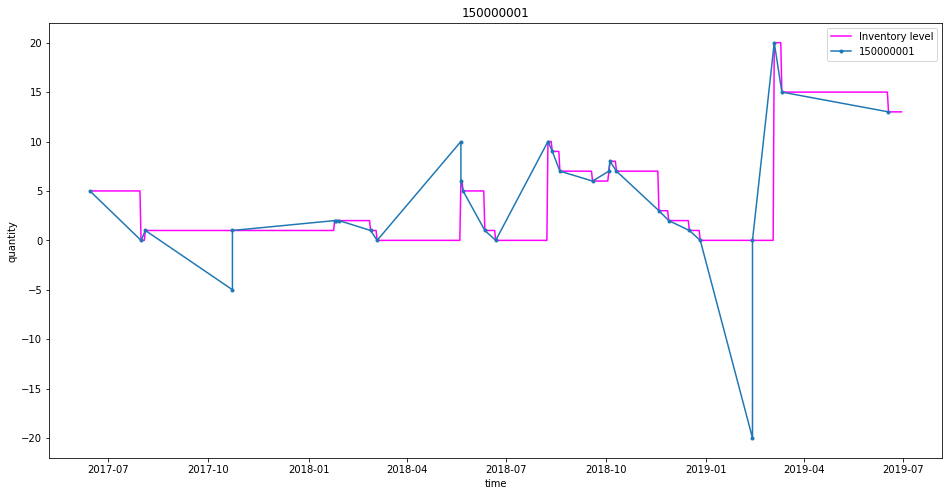

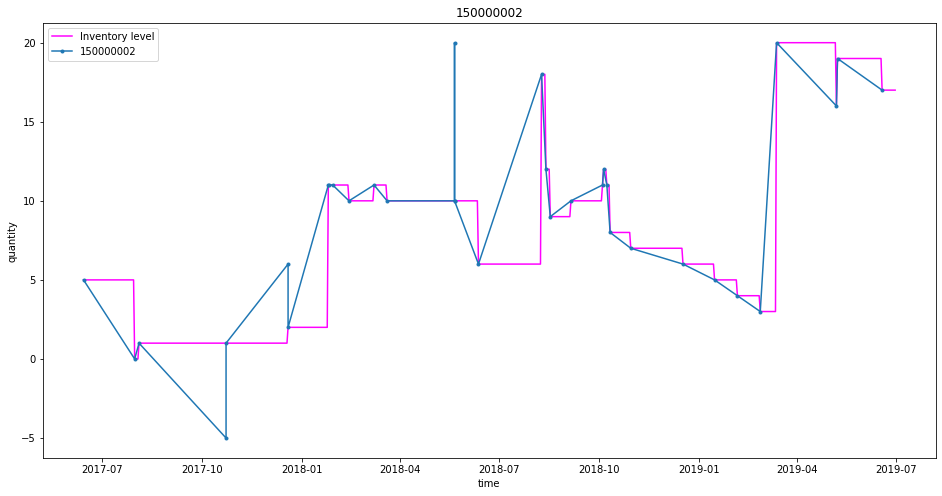

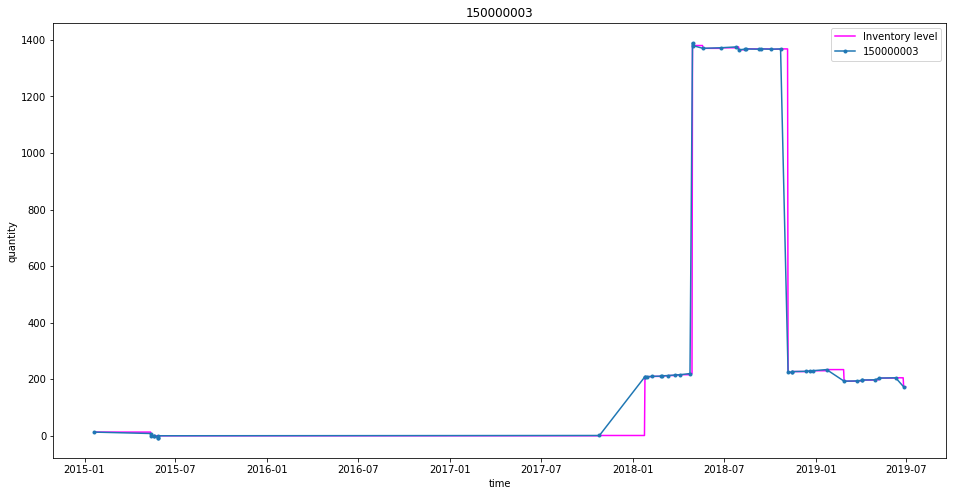

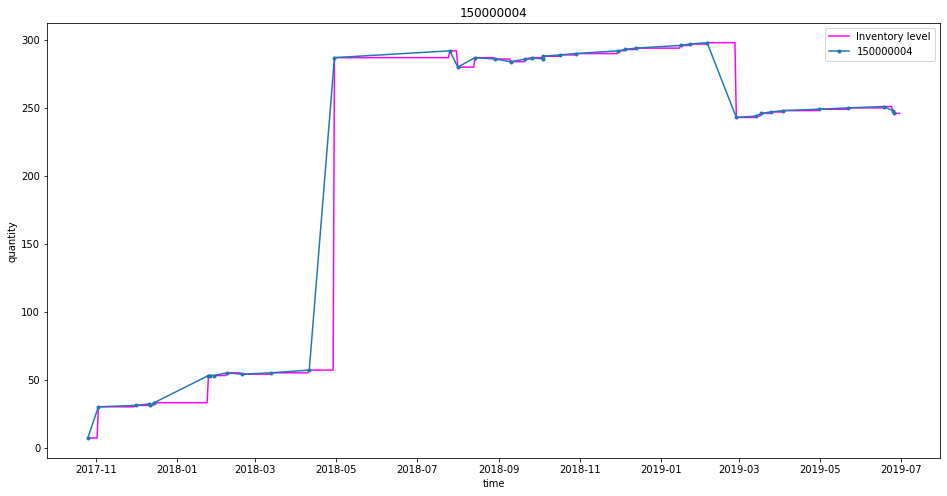

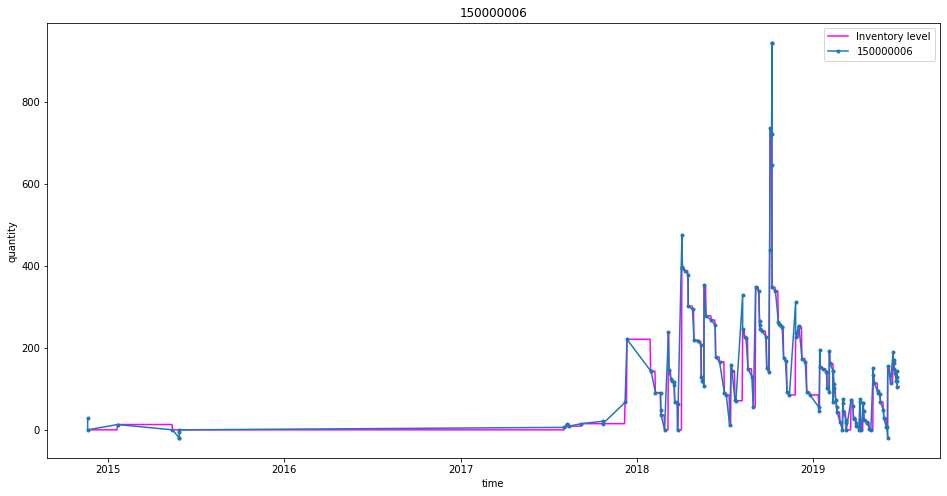

...

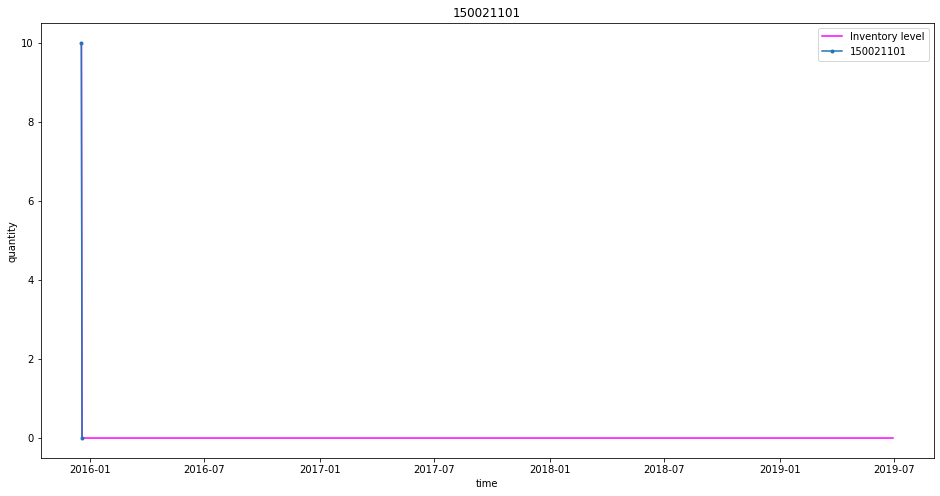

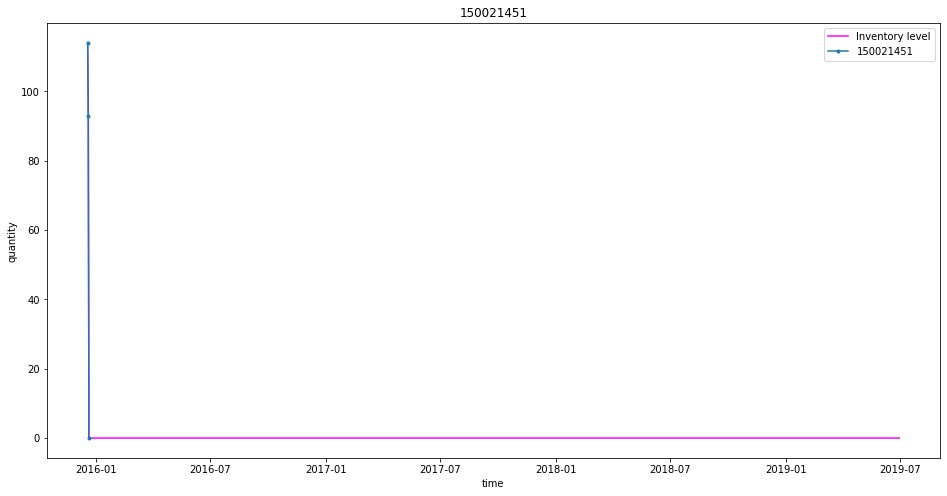

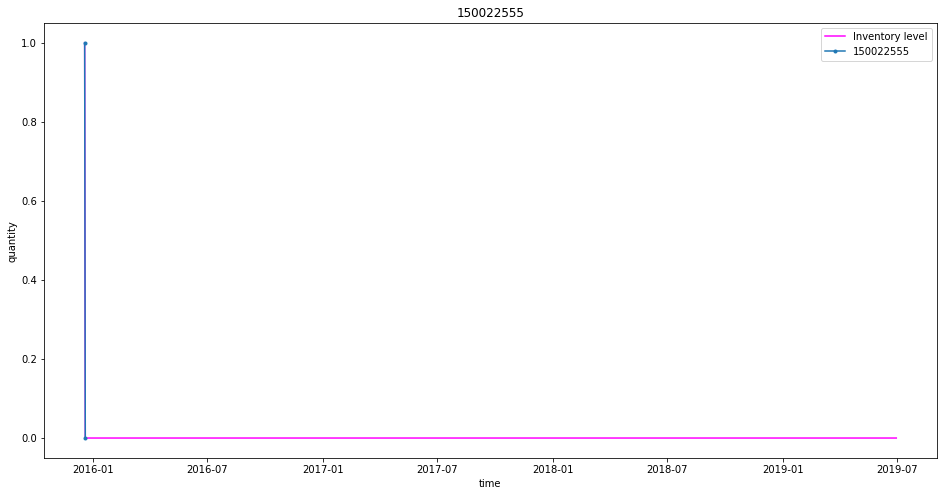

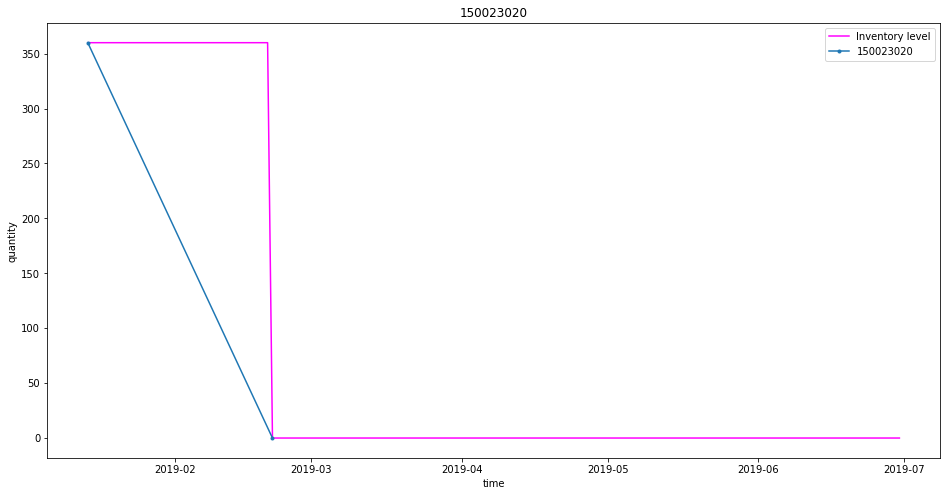

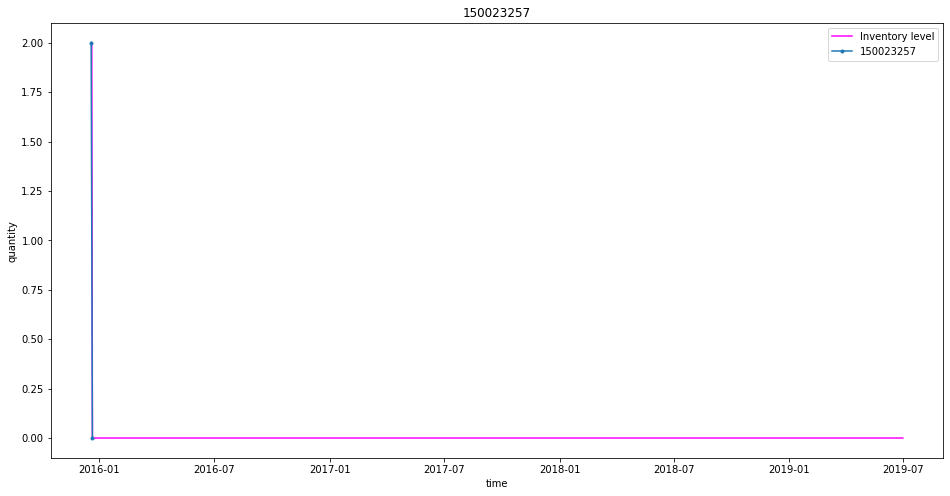

<Figure size 1152x576 with 0 Axes>

In [66]:
grp_inv_m = grp_inv.groupby(["MaterialNumber"])
# grp_merge = df_merge.groupby(["MaterialNumber"])
for index,group in grp_mov.groupby(["MaterialNumber"]):
    plt.figure(figsize=(16,8))
    print(index)
#     print(group)
    group["cumulative"] = group["Quantity_SUM"].cumsum(axis = 0) 
    group2 = grp_inv_m.get_group(index)
    
    
    group2.PostingDate = group2.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))        
    plt.plot( group2.set_index(["PostingDate"])["ClosingStock_SUM_SUM"], color = "magenta",label = "Inventory level")
    plt.plot( group.set_index(["PostingDate"])["cumulative"], marker='.', label=index)
#     plt.plot( group.set_index(["PostingDate"])["diff"], marker='.', label="diff",color = 'green')

    plt.title(index)
    plt.xlabel("time")
    plt.ylabel('quantity')
    plt.legend()
#     plt.show()
    plt.savefig("/home/bharat/proj/hackathon/graphs/inc_allC002/" + 'Graph_{}.png'.format(index), format="PNG")  

In [ ]:
#     group[["cumulative", "Quantity_SUM"]] = group[["cumulative", "Quantity_SUM"]].apply(pd.to_numeric)
#     group["cumulative"] =  pd.to_numeric(group["cumulative"])
#     group = group.apply(pd.to_numeric)
#     group.astype({'cumulative': 'int32','Quantity_SUM': 'int32'}).dtypes


150000001
    MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
0        150000001  2017-06-14         5.0   0.0                   5.0
25       150000001  2017-07-31         0.0  25.0                  20.0
1        150000001  2017-08-04         1.0  -1.0                   0.0
26       150000001  2017-10-23        -5.0  21.0                  15.0
2        150000001  2017-10-23         1.0  -5.0                   1.0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.or

150000002
    MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
28       150000002  2017-06-14         5.0   0.0                   5.0
54       150000002  2017-07-31         0.0  25.0                  20.0
29       150000002  2017-08-04         1.0  -1.0                   0.0
30       150000002  2017-10-23         7.0  -5.0                   1.0
55       150000002  2017-10-23         1.0  22.0                  16.0
150000003
    MaterialNumber PostingDate  cumulative   diff  ClosingStock_SUM_SUM
85       150000003  2015-01-20        13.0  215.0                 228.0
90       150000003  2015-05-14         8.0  199.0                 194.0
92       150000003  2015-05-14         0.0  205.0                 197.0
58       150000003  2015-05-20         1.0   12.0                  13.0
93       150000003  2015-05-20         0.0  199.0                 198.0
150000004
     MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
97        150000004  2017-10-26         

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


      MaterialNumber PostingDate  cumulative    diff  ClosingStock_SUM_SUM
1526       150000028  2014-11-19       -22.0  1406.0                1384.0
1534       150000028  2014-11-19         0.0     NaN                   NaN
1466       150000028  2015-01-05        11.0     5.0                  16.0
1467       150000028  2015-01-29        16.0    13.0                  18.0
1468       150000028  2015-05-05        18.0    21.0                  23.0
150000029
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
1537       150000029  2015-05-05         1.0  -1.0                   0.0
1603       150000029  2015-05-14         0.0  17.0                  16.0
1538       150000029  2015-05-28         1.0  -1.0                   0.0
1604       150000029  2015-05-28         0.0  17.0                  16.0
1607       150000029  2015-07-16       -11.0  23.0                  12.0
150000030
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
1614       15000003

      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2280       150000667  2015-12-19        -1.0   NaN                   NaN
150000669
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2281       150000669  2015-12-21        -1.0   NaN                   NaN
150000697
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2282       150000697  2015-12-19       -22.0   NaN                   NaN
2283       150000697  2015-12-21       -26.0   NaN                   NaN
150000698
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2284       150000698  2015-12-19        -5.0   NaN                   NaN
150000960
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2285       150000960  2019-02-25         1.0   NaN                   NaN
2286       150000960  2019-02-25         0.0   NaN                   NaN
150002122
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2

      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2349       150009873  2018-09-27        10.0   NaN                   NaN
150010289
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2350       150010289  2015-12-19       -85.0   NaN                   NaN
2351       150010289  2015-12-21       -86.0   NaN                   NaN
150010473
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2352       150010473  2015-12-19        -2.0   NaN                   NaN
150010876
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2354       150010876  2019-01-09        -1.0   NaN                   NaN
2353       150010876  2019-01-09         0.0   NaN                   NaN
150011190
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2355       150011190  2019-06-05         3.0   NaN                   NaN
2356       150011190  2019-06-05         0.0   NaN                   NaN
150011722
 

      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2415       150026602  2015-12-19      -200.0   NaN                   NaN
2416       150026602  2015-12-21      -300.0   NaN                   NaN
150026621
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2417       150026621  2015-12-19        -4.0   NaN                   NaN
2418       150026621  2015-12-21        -8.0   NaN                   NaN
150027478
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2419       150027478  2018-02-28        -1.0  41.0                  40.0
2423       150027478  2018-03-06        -7.0  29.0                  23.0
2424       150027478  2018-04-27        -8.0  29.0                  28.0
2425       150027478  2018-05-10        -9.0  42.0                  41.0
2426       150027478  2018-05-14       -11.0  41.0                  39.0
150028486
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2434       150028486 

      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2681       150034840  2015-05-05         1.0  -1.0                   0.0
2687       150034840  2015-05-08         0.0   1.0                   0.0
2682       150034840  2018-01-19         1.0   0.0                   1.0
2688       150034840  2018-04-18         0.0   NaN                   NaN
2683       150034840  2018-05-25         1.0   1.0                   2.0
150034842
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2699       150034842  2017-11-15         1.0   5.0                   6.0
2691       150034842  2018-02-06         3.0  -2.0                   0.0
2700       150034842  2018-02-19         9.0   1.0                   7.0
2701       150034842  2018-02-20        10.0  11.0                  12.0
2702       150034842  2018-04-27        11.0  -1.0                   0.0
150034843
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
2709       150034843  2017-08-1

      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
3012       150035218  2015-12-19        -1.0   NaN                   NaN
150035220
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
3013       150035220  2017-05-10         1.0   NaN                   NaN
3014       150035220  2018-06-19         0.0   NaN                   NaN
150035221
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
3015       150035221  2014-08-18         1.0  -1.0                   0.0
3016       150035221  2015-05-05         2.0  -1.0                   0.0
3017       150035221  2015-05-08         6.0  -4.0                   0.0
3024       150035221  2015-05-14         0.0   6.0                   0.0
3018       150035221  2015-05-20         1.0  -1.0                   0.0
150035222
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
3029       150035222  2017-05-10        20.0   NaN                   NaN
3030       150035222 

150063518
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
3171       150063518  2018-03-13         1.0   NaN                   NaN
3173       150063518  2018-04-30         2.0   NaN                   NaN
3172       150063518  2018-07-25         1.0   NaN                   NaN
3174       150063518  2018-11-09         3.0   NaN                   NaN
150064674
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
3175       150064674  2018-05-10       180.0   NaN                   NaN
3176       150064674  2018-05-10         0.0   NaN                   NaN
150065207
      MaterialNumber PostingDate  cumulative  diff  ClosingStock_SUM_SUM
3180       150065207  2017-12-01        -1.0   5.0                   4.0
3177       150065207  2017-12-01         0.0   4.0                   5.0
3178       150065207  2017-12-05         5.0  -1.0                   4.0
3181       150065207  2018-02-19         3.0   5.0                   3.0
3179       150065207 

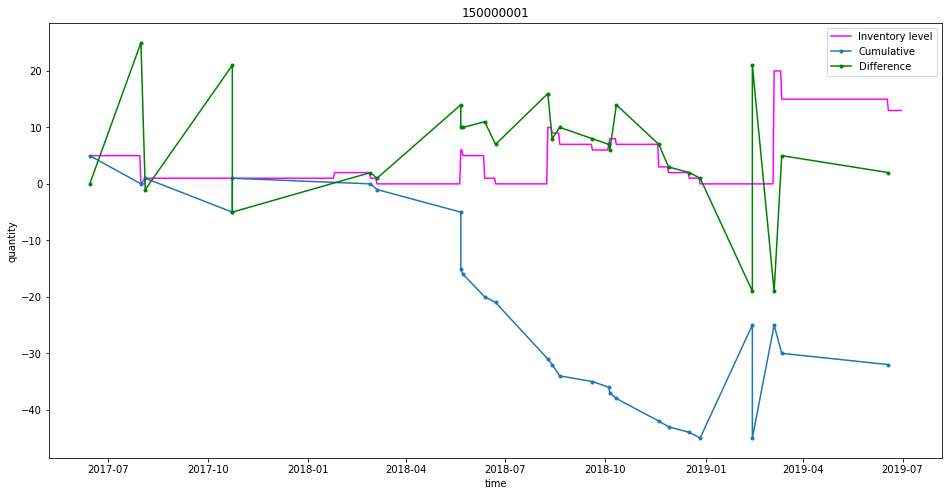

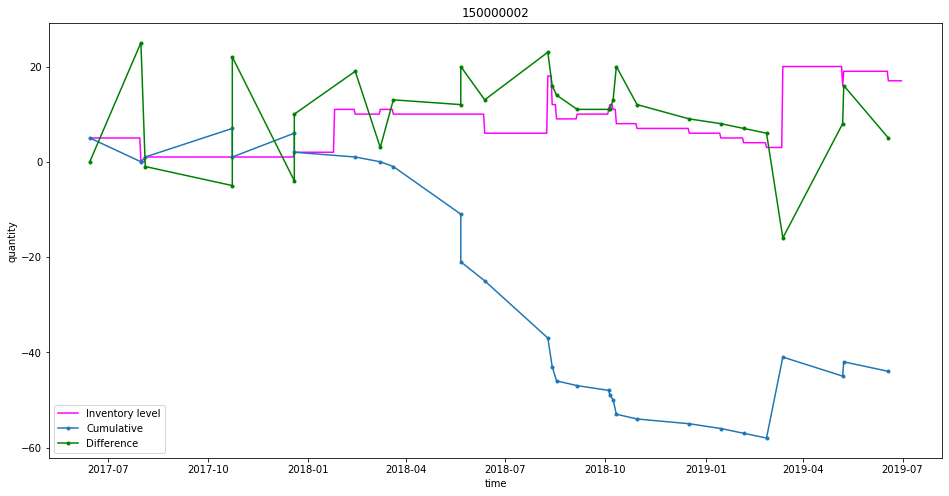

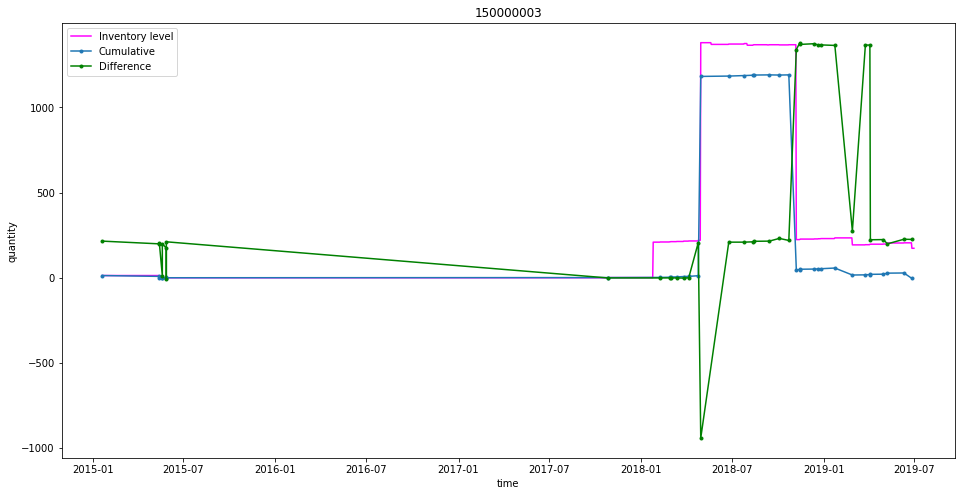

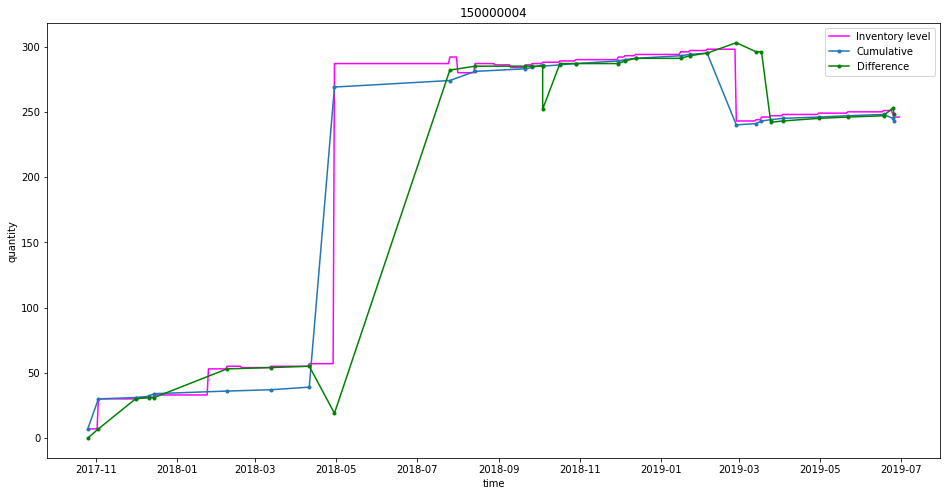

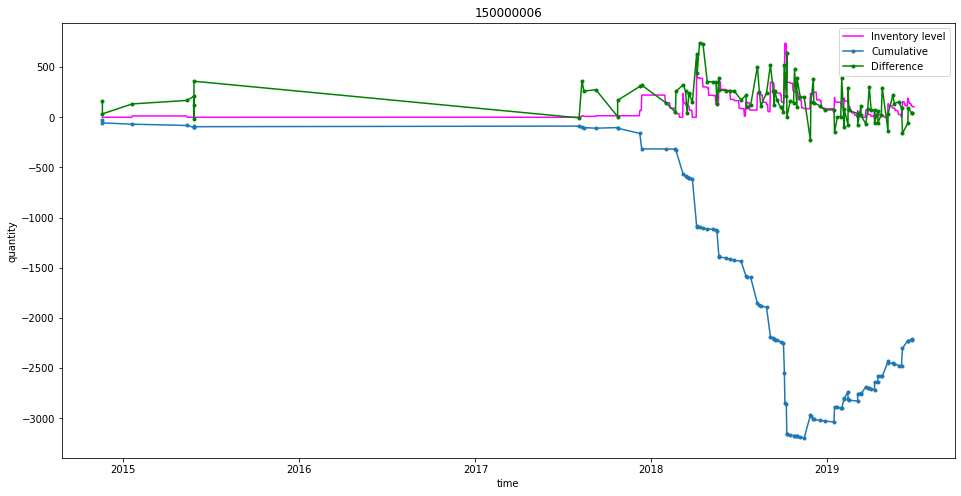

...

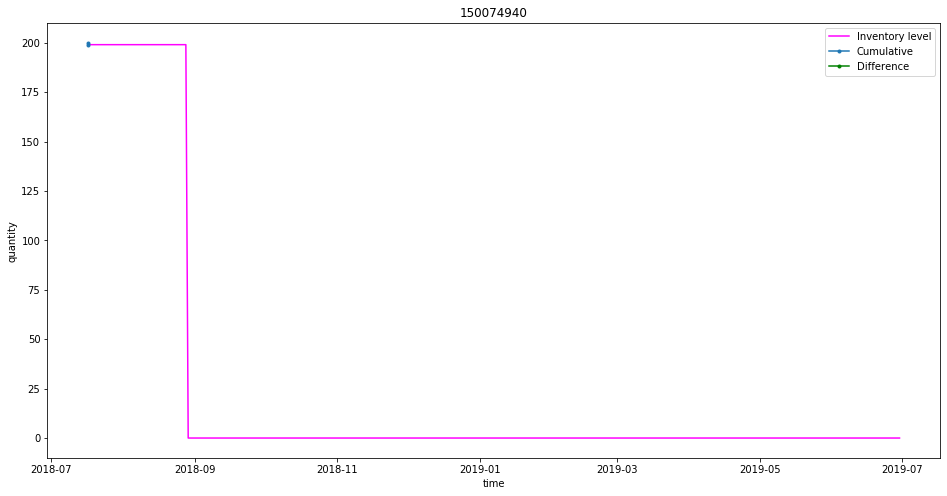

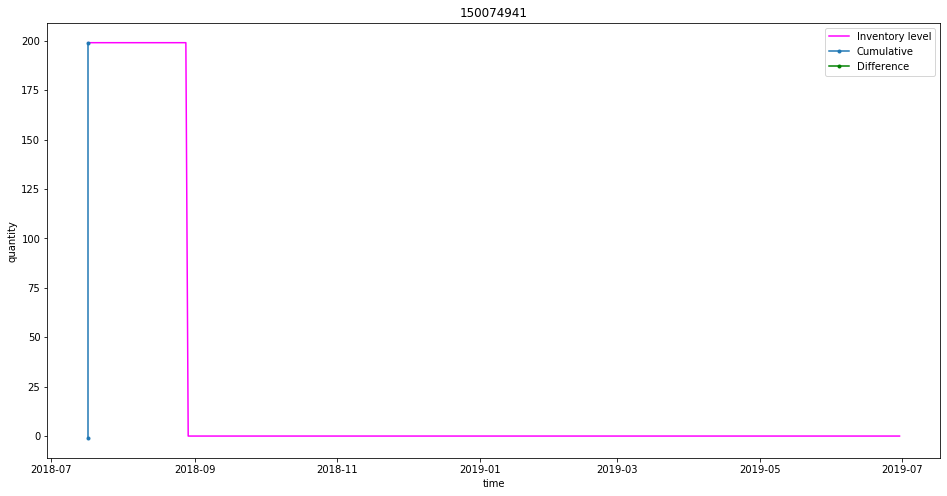

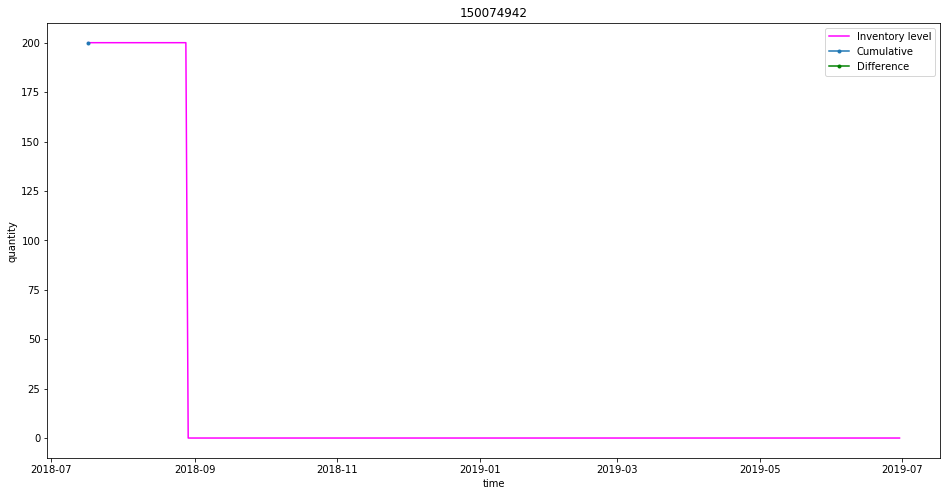

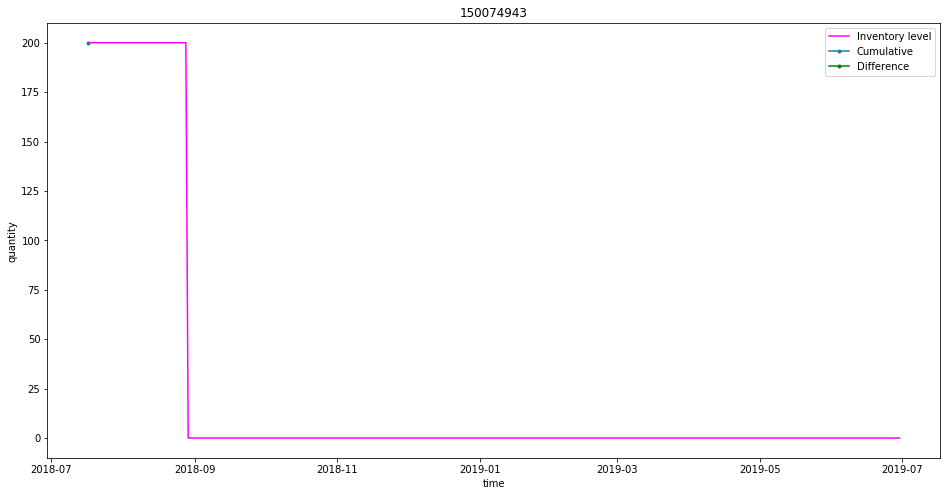

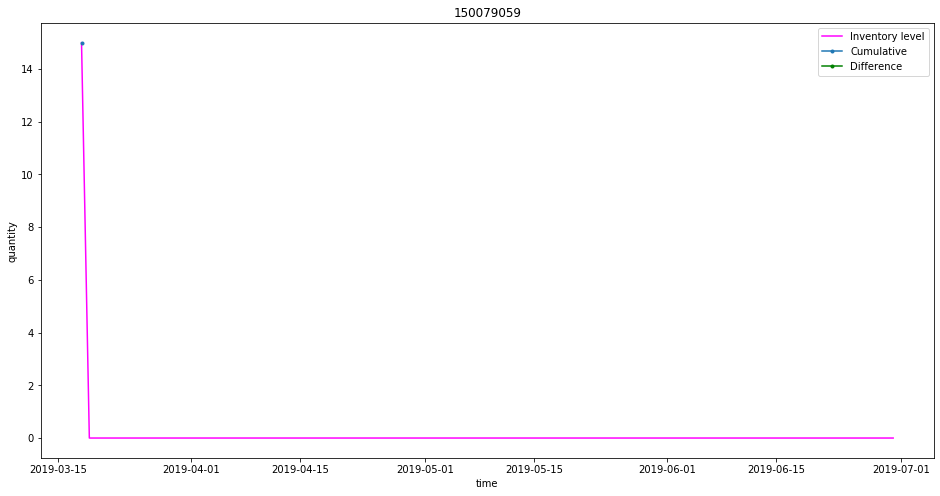

In [189]:
# grp_inv_m = grp_inv.groupby(["MaterialNumber"])
# grp_merge = df_merge.groupby(["MaterialNumber"])
# for index,group in grp_mov.groupby(["MaterialNumber"]):
#     plt.figure(figsize=(16,8))
#     print(index)

#     group["cumulative"] = group["Quantity_SUM"].cumsum(axis = 0)
#     group2 = grp_inv_m.get_group(index)
#     group3 = grp_merge.get_group(index)
# #     print(group3.head())
    
# #     print(type(group))

# #     print(type(group["cumulative"]))
#     group["diff"] = group3["ClosingStock_SUM_SUM"] - group["Quantity_SUM"]
#     group["ClosingStock_SUM_SUM"] = group3["ClosingStock_SUM_SUM"]
#     del group["Quantity_SUM"]
#     print(group.head())
#     group2.PostingDate = group2.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))        
#     plt.plot( group2.set_index(["PostingDate"])["ClosingStock_SUM_SUM"], color = "magenta",label = "Inventory level")
#     plt.plot( group.set_index(["PostingDate"])["cumulative"], marker='.', label="Cumulative")
#     plt.plot( group.set_index(["PostingDate"])["diff"], marker='.', label="Difference",color = 'green')

#     plt.title(index)
#     plt.xlabel("time")
#     plt.ylabel('quantity')
#     plt.legend()
# #     plt.show()
#     plt.savefig("/home/bharat/proj/hackathon/graphs/main_diff1C002/" + 'Graph_{}.png'.format(index), format="PNG")  

### Merge

In [174]:
df_merge = grp_inv.merge(grp_mov,on = ["MaterialNumber","PostingDate"],how = "inner")

# pd.merge(main_df1, main_df2, on=["MaterialNumber","StorageLocation","PostingDate"])

print(df_merge.shape)

print(df_merge.head())

# print(df_merge.StorageLocation.value_counts())

# print(df_merge.MovementType.value_counts())

(3398, 4)
   MaterialNumber PostingDate  ClosingStock_SUM_SUM  Quantity_SUM
0       150000001  2017-06-14                   5.0           5.0
1       150000001  2017-07-31                   0.0          -5.0
2       150000001  2017-08-04                   1.0           1.0
3       150000001  2017-10-23                   1.0          -6.0
4       150000001  2017-10-23                   1.0           6.0


In [50]:
del df_merge["MovementType"]

150000001
150000002


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


150000003
150000004
150000006
150000007
150000008
150000009
150000010
150000011
150000012
150000013
150000015
150000016
150000017
150000018
150000022
150000023
150000026
150000027


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


150000028
150000029
150000030
150000031
150000032
150000033
150000034
150000036
150000037
150000038
150000039
150000043
150000044
150000049
150000050
150000051
150000052
150000055
150000056
150000263
150000462
150000667
150000669
150000697
150000698
150000960
150002122
150002279
150002339
150002377
150002915
150003301
150003627
150003628
150003757
150003884
150003970
150004002
150004235
150004516
150004730
150004751
150004856
150006080
150006144
150006347
150006532
150006707
150006885
150007006
150007925
150007983
150008381
150008445
150008508
150008759
150008784
150009188
150009223
150009864
150009873
150010289
150010473
150010876
150011190
150011722
150011959
150011961
150012308
150012514
150013018
150014441
150014562
150014902
150014904
150015041
150016480
150016659
150017040
150017647
150017887
150017958
150018039
150018354
150018355
150018672
150018699
150020142
150020758
150020795
150020960
150021062
150021101
150021451
150022555
150023020
150023257
150023536
150023537
150023576


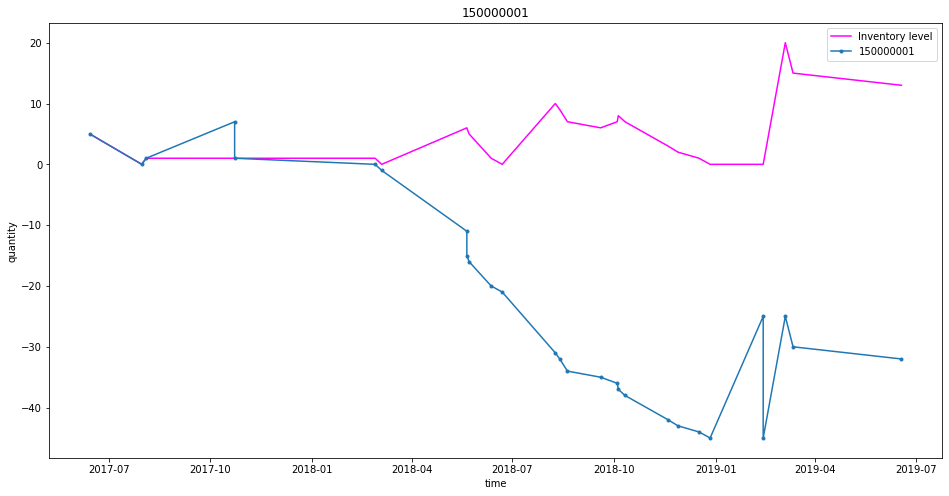

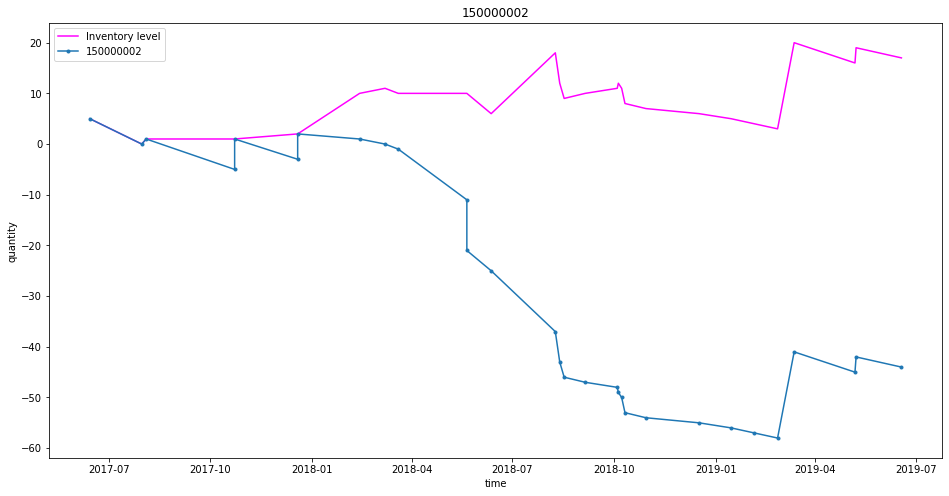

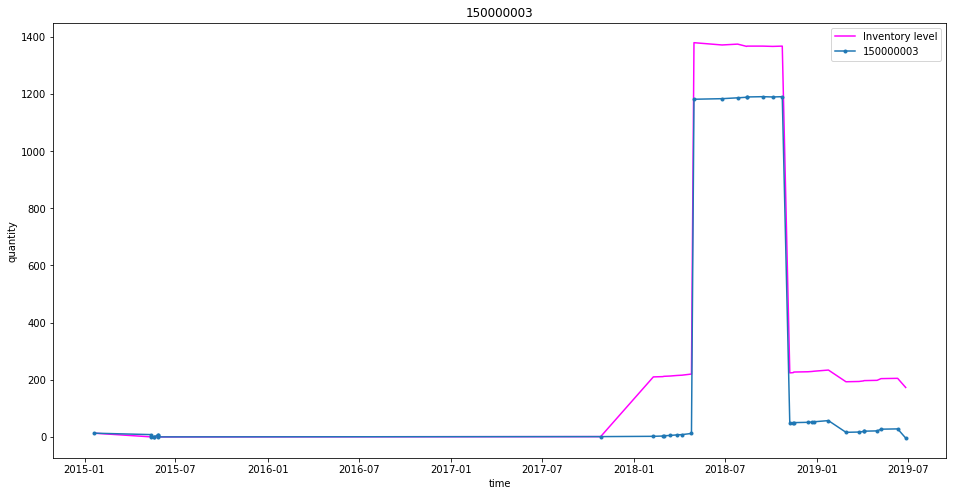

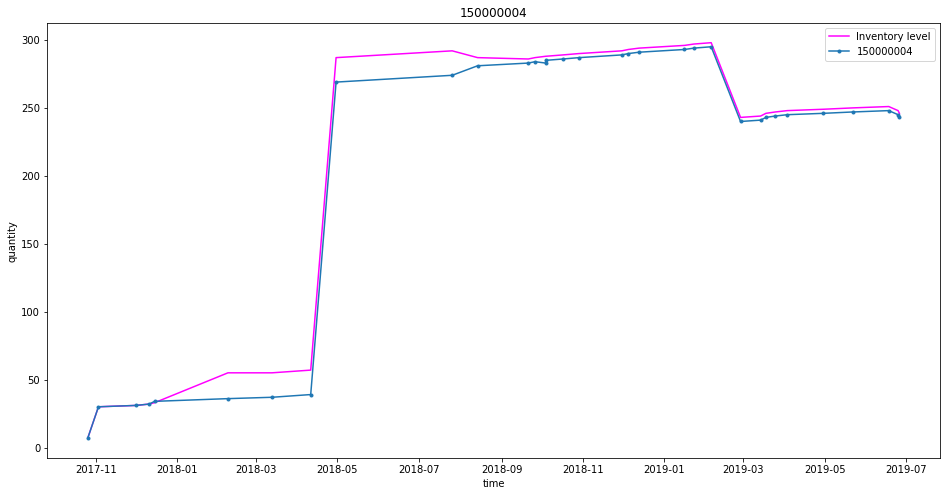

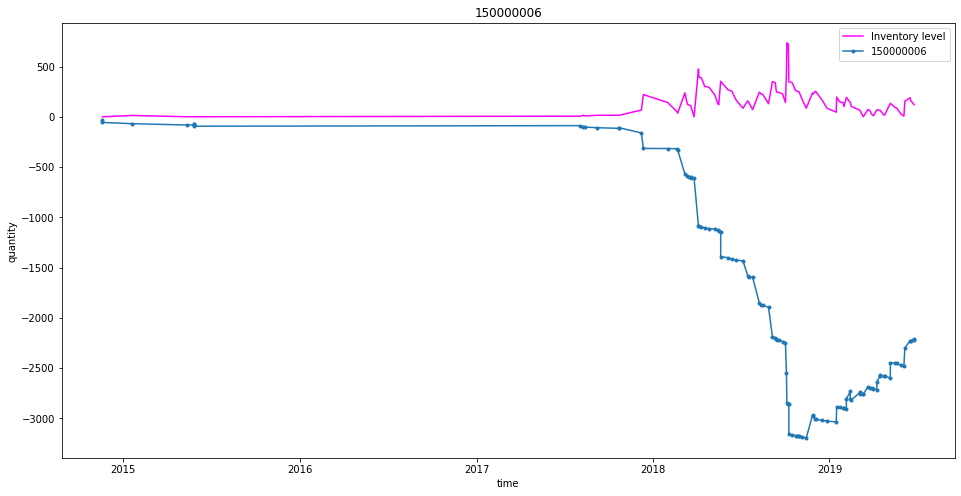

...

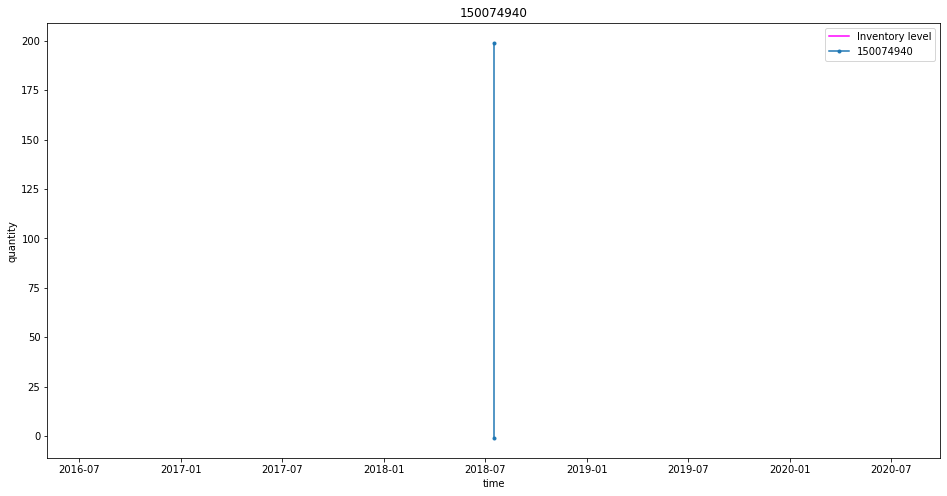

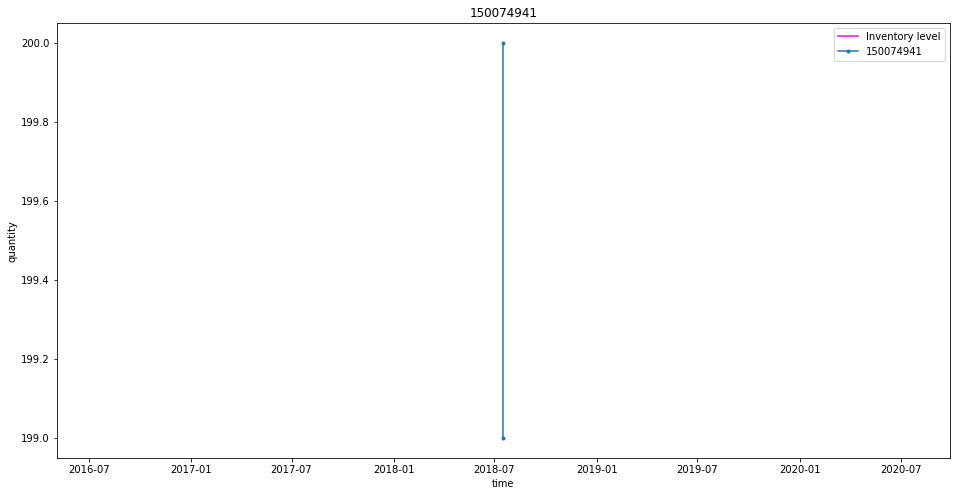

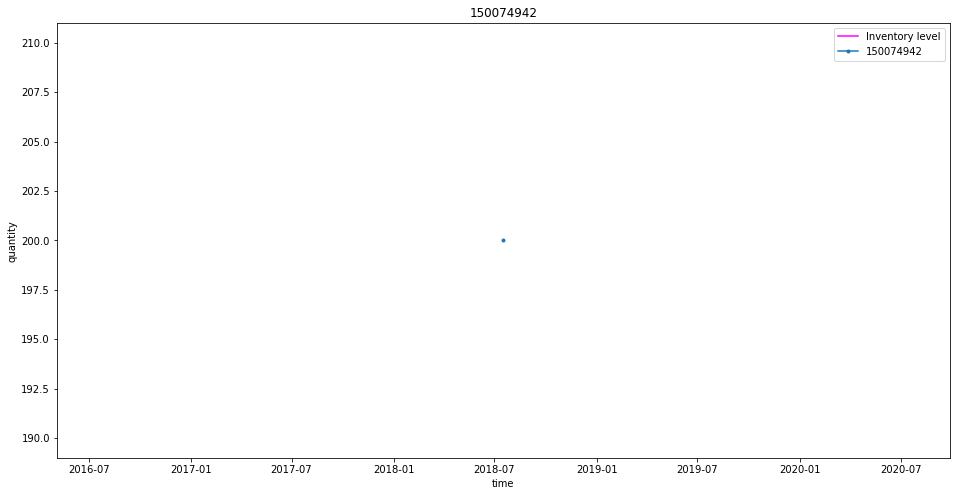

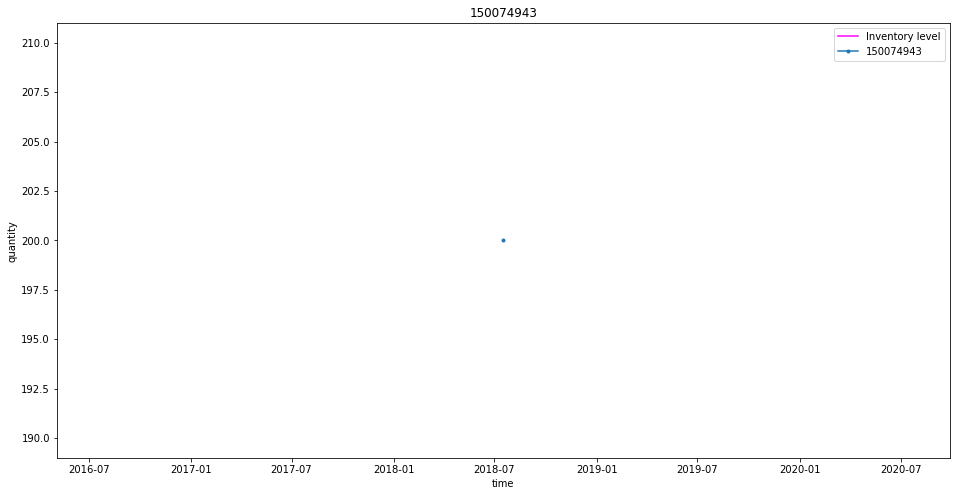

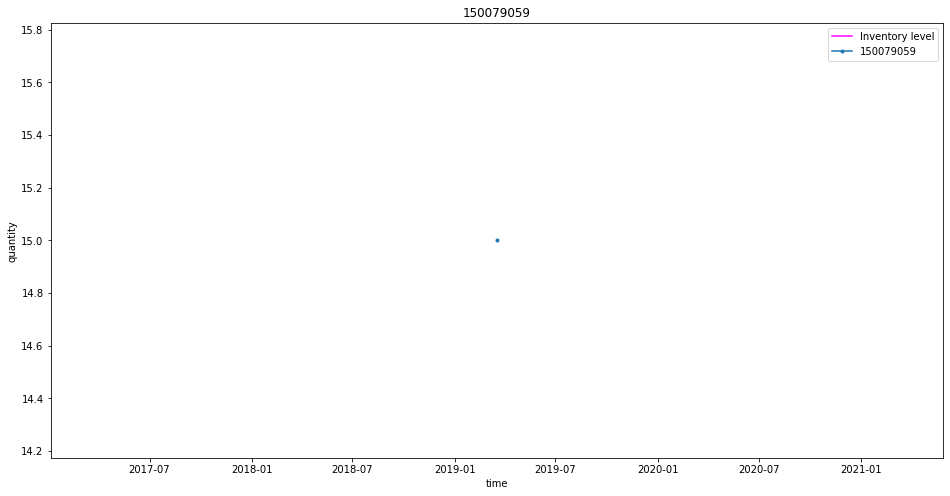

In [56]:
# grp_inv_m = grp_inv.groupby(["MaterialNumber"])
for index,group in df_merge.groupby(["MaterialNumber"]):
    plt.figure(figsize=(16,8))
    print(index)
#     print(group)
    group["cumulative"] = group["Quantity_SUM"].cumsum(axis = 0) 
#     group2 = grp_inv_m.get_group(index)
#     group2.PostingDate = group2.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))        
    plt.plot( group.set_index(["PostingDate"])["ClosingStock_SUM_SUM"], color = "magenta",label = "Inventory level")
    plt.plot( group.set_index(["PostingDate"])["cumulative"], marker='.', label=index)
    plt.title(index)
    plt.xlabel("time")
    plt.ylabel('quantity')
    plt.legend()
#     plt.show()
    plt.savefig("/home/bharat/proj/hackathon/graphs/merged_df_C002/" + 'Graph_{}.png'.format(index), format="PNG")  

In [220]:



#     for index2,group2 in group.groupby(["MovementType"]):
#         group3 = grp_inv_m.get_group(index)
#         group3.PostingDate = group3.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))        
#         plt.plot( group3.set_index(["PostingDate"])["ClosingStock_SUM_SUM"], color = "magenta")
#         plt.plot( group2.set_index(["PostingDate"])["cumulative"], marker='.', label=index2)
#         plt.title(index)
#     plt.xlabel("time")
#     plt.ylabel('quantity')
#     plt.legend()
#     plt.show()
#     plt.savefig("/home/bharat/proj/hackathon/graphs/MC004/" + 'Graph_{}.png'.format(index), format="PNG")  


In [221]:
# grp_inv_m = grp_inv.groupby(["MaterialNumber"])
# for index,group in grp_mov.groupby(["MaterialNumber"]):
#     plt.figure(figsize=(16,8))
#     print(index)
#     for index2,group2 in group.groupby(["MovementType"]):
#         group3 = grp_inv_m.get_group(index)
#         group3.PostingDate = group3.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))        
#         plt.plot( group3.set_index(["PostingDate"])["ClosingStock_SUM_SUM"], color = "magenta")
#         plt.plot( group2.set_index(["PostingDate"])["Quantity_SUM"], marker='.', label=index2)
#         plt.title(index)
#     plt.xlabel("time")
#     plt.ylabel('quantity')
#     plt.legend()
# #     plt.show()
#     plt.savefig("/home/bharat/proj/hackathon/graphs/MC004/" + 'Graph_{}.png'.format(index), format="PNG")  


In [74]:
# current_date = "20190630"

# current_date = pd.to_datetime(current_date, format="%Y%m%d")
# ff = current_date - timedelta(days = 730)

In [77]:
# ff

In [76]:
# current_date = "20190630"

# current_date = pd.to_datetime(current_date, format="%Y%m%d")
# group3 = group3.apply(lambda x: x["PostingDate"].between(current_date, current_date-pd.to_timedelta(730, unit='d')))

In [144]:
df_mov = df_mov[df_mov.MovementType.isin([101, 102, 261, 262, 551])]
df_mov.head()

,PostingDate,StorageLocation,MaterialNumber,MovementType,Quantity_SUM
11510,20141025,105,150032015,261,1.0
11511,20141025,105,150033199,261,1.0
11512,20141025,105,150033858,261,1.0
11513,20141025,105,150026497,261,2.0
11516,20141025,105,150032545,261,1.0


In [145]:
grp_mov = df_mov.groupby(["MaterialNumber","MovementType","PostingDate"]).sum()

In [146]:
grp_mov1 = grp_mov.reset_index()
del grp_mov1["StorageLocation"]

In [147]:
# grp_mov.StorageLocation.value_counts()

In [165]:
grp_mov1.shape

(74207, 4)

In [168]:
grp_mov2 = grp_mov1.copy()

In [169]:
grp_mov2.head()

,MaterialNumber,MovementType,PostingDate,Quantity_SUM
0,150000002,262,20170603,1.0
1,150000003,262,20171109,1.0
2,150000004,262,20141111,1.0
3,150000004,262,20141231,1.0
4,150000005,261,20160928,1.0


In [170]:
grp_mov2['Quantity_SUM'].loc[grp_mov2['MovementType'].isin([102,261,551])] = -grp_mov2["Quantity_SUM"]
# grp_mov2['Quantity_SUM'].loc[grp_mov2['MovementType'] == 101] = -grp_mov2["Quantity_SUM"]

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:190: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


In [171]:
grp_mov2.head(20)

,MaterialNumber,MovementType,PostingDate,Quantity_SUM
0,150000002,262,20170603,1.0
1,150000003,262,20171109,1.0
2,150000004,262,20141111,1.0
3,150000004,262,20141231,1.0
4,150000005,261,20160928,-1.0
5,150000005,262,20160226,1.0
6,150000006,101,20150806,30.0
7,150000006,261,20150309,-1.0
8,150000006,261,20150820,-1.0
9,150000006,261,20150910,-1.0


In [172]:
grp_mov2.shape

(74207, 4)

In [173]:
grpd = grp_mov2.groupby("MaterialNumber")

In [177]:
df_n = grpd.get_group(150000006)
df_n

,MaterialNumber,MovementType,PostingDate,Quantity_SUM
6,150000006,101,20150806,30.0
7,150000006,261,20150309,-1.0
8,150000006,261,20150820,-1.0
9,150000006,261,20150910,-1.0
10,150000006,261,20150922,-1.0
11,150000006,261,20150924,-1.0
12,150000006,261,20150925,-2.0
13,150000006,261,20150926,-1.0
14,150000006,261,20151001,-1.0
15,150000006,261,20151009,-3.0


In [178]:
df_n["cumulative"] = df_n["Quantity_SUM"].cumsum(axis = 0) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [179]:
df_n.head()

,MaterialNumber,MovementType,PostingDate,Quantity_SUM,cumulative
6,150000006,101,20150806,30.0,30.0
7,150000006,261,20150309,-1.0,29.0
8,150000006,261,20150820,-1.0,28.0
9,150000006,261,20150910,-1.0,27.0
10,150000006,261,20150922,-1.0,26.0


In [222]:
df_mov.head()

,PostingDate,StorageLocation,MaterialNumber,MovementType,Quantity_SUM
11510,20141025,105,150032015,261,1.0
11511,20141025,105,150033199,261,1.0
11512,20141025,105,150033858,261,1.0
11513,20141025,105,150026497,261,2.0
11516,20141025,105,150032545,261,1.0


In [53]:
df_mov["PostingDate"] = df_mov["PostingDate"].apply(lambda x: pd.to_datetime(x, format="%Y%m%d"))

In [33]:
# df["frequency"] = df["frequency"].apply(lambda x: pd.to_datetime(x, format="%Y%m%d"))

In [54]:
# grp_mov2['Quantity_SUM'].loc[grp_mov2['MovementType'].isin([102,261,551])] = -grp_mov2["Quantity_SUM"]


In [ ]:
grp_inv_m = grp_inv.groupby(["MaterialNumber"])
for index,group in grp_mov.groupby(["MaterialNumber"]):
    plt.figure(figsize=(16,8))
    print(index)
    for index2,group2 in group.groupby(["MovementType"]):
        group3 = grp_inv_m.get_group(index)
        group3.PostingDate = group3.PostingDate.apply(lambda x : pd.to_datetime(x,format = '%Y%m%d', errors='ignore'))        
        plt.plot( group3.set_index(["PostingDate"])["ClosingStock_SUM_SUM"], color = "magenta")
        plt.plot( group2.set_index(["PostingDate"])["Quantity_SUM"], marker='.', label=index2)
        plt.title(index)
    plt.xlabel("time")
    plt.ylabel('quantity')
    plt.legend()
#     plt.show()
    plt.savefig("/home/bharat/proj/hackathon/graphs/MC004/" + 'Graph_{}.png'.format(index), format="PNG")  


# time series

In [238]:
grp_mov.head()

,MaterialNumber,PostingDate,Quantity_SUM
19871,150026497,2014-10-25,12.0
13074,150017509,2014-10-25,1.0
34639,150032545,2014-10-25,1.0
41656,150033644,2014-10-25,1.0
36586,150033199,2014-10-25,2.0


In [239]:
grp_mov.shape

(47853, 3)

In [240]:
# for index,group in grp_mov.groupby(["MaterialNumber"]):
#     plt.figure(figsize=(16,8))
#     print(index)
# #     print(group)
# #     group["cumulative"] = group["Quantity_SUM"].cumsum(axis = 0)     
#     plt.plot( group.set_index(["PostingDate"])["Quantity_SUM"], marker='.', label=index)
# #     plt.plot( group.set_index(["PostingDate"])["diff"], marker='.', label="diff",color = 'green')

#     plt.title(index)
#     plt.xlabel("time")
#     plt.ylabel('quantity')
#     plt.legend()
# #     plt.show()
#     plt.savefig("/home/bharat/proj/hackathon/graphs/solnC004/" + 'Graph_{}.png'.format(index), format="PNG") 

In [241]:
# for index,group in grp_mov.groupby(["MaterialNumber"]):
#     print(group.head())
 

In [242]:


##n_series to find the individual series for a kunag,matnr combination
def n_series(input_df,matnr): 
    df = input_df.copy()
#     print(df.head())
#     print("matnr :",matnr)
    n_df1 = df[(df["MaterialNumber"] == matnr)]
#     print(n_df1.head())

    #sort date start to end
    n_df1 = n_df1.sort_values('PostingDate')
    n_df1.set_index('PostingDate',inplace=True)
#     print(n_df1.head())

    #sampling the data on weekly basis (index is set to date first in the above step to do weekly sampling
    weekly_resampled_data = n_df1.Quantity_SUM.resample('M').sum() 
    weekly_resampled_data = weekly_resampled_data.replace(np.nan, 0)
    individual_series = weekly_resampled_data.to_frame()     
    #resetting index so that date can be used as column
    individual_series = individual_series.reset_index()
    return individual_series

#splitting the individual series basesd on the number of weeks (i, is for dyanamic point forecasts)
def train_test_split(input_df,matnr,i):
    data= n_series(input_df,matnr)
    train = data.iloc[0:-i]    
    test = data.iloc[-i:]
    return train,test

In [243]:
#  for i in range (1,3):
#             matnr = int(grp_mov["MaterialNumber"].iloc[i])
# #             print("count",cnt)
#             print(matnr)
# #             train,test = train_test_split(grp_mov,matnr,16)
# #             print(train.head())
#             df = n_series(grp_mov,matnr)
# #             print(df.head())


In [244]:
def naive(input_df,matnr,n):
#     path = "/home/rahul/Downloads/bharat/time_series1/model_graphs/"
#     folder = path+"/naive"
#     if not os.path.exists(folder):
#         os.makedirs(folder)
    index = str(matnr)
    i = 0
    lst = []
    test1 = train_test_split(input_df,matnr,n)[1]
    y_hat = test1.copy()
    
    for i in range(n,0,-1):
        train,test = train_test_split(input_df,matnr,i)
        dd= np.asarray(train["Quantity_SUM"])
        y_hat['naive'] = int(dd[len(dd)-1])
        pred = y_hat['naive']
        lst.append(pred.iloc[-1])

    
    pd.DataFrame(lst)
    y_hat['pred_column']=lst
    plt.figure(figsize=(12,8))
    plt.plot( train.set_index("PostingDate")['Quantity_SUM'], label='Train',marker = '.')
    plt.plot(test1.set_index("PostingDate")['Quantity_SUM'], label='Test',marker = '.')
    plt.plot(y_hat.set_index("PostingDate")['pred_column'], label='Naive Forecast',marker = '.')
    plt.legend(loc='best')
    plt.title("Naive Forecast")
#     plt.savefig(folder +"/" + 'Graph_{}.png'.format(index), format="PNG")  

    plt.show()

    rms = sqrt(mean_squared_error(test1.Quantity_SUM, y_hat.pred_column))
    mae = mean_absolute_error(test1.Quantity_SUM, y_hat.pred_column)
    del y_hat['naive']
    return y_hat,rms,mae


In [245]:
def moving_average(input_df,matnr,n,roll):

    index = str(matnr)
    i = 0
    lst = []
    test1 = train_test_split(input_df,matnr,n)[1]
#     y_hat = test1.copy()
    y_hat_avg = test1.copy()

    for i in range(n,0,-1):
        train,test = train_test_split(input_df,matnr,i)
        dd= np.asarray(train["Quantity_SUM"])
        y_hat_avg['moving_avg_forecast'] = train['Quantity_SUM'].rolling(roll).mean().iloc[-1]
        pred = y_hat_avg['moving_avg_forecast']
        lst.append(pred.iloc[-1])

    pd.DataFrame(lst)
    y_hat_avg['pred_column']=lst
    plt.figure(figsize=(12,8))
    plt.plot( train.set_index("PostingDate")['Quantity_SUM'], label='Train',marker = '.')
    plt.plot(test1.set_index("PostingDate")['Quantity_SUM'], label='Test',marker = '.')
    plt.plot(y_hat_avg.set_index("PostingDate")['pred_column'], label='moving_avg_forecast',marker = '.')
    plt.legend(loc='best')
    plt.title("moving_avg_forecast")

    plt.show()
    rms = sqrt(mean_squared_error(test1.Quantity_SUM, y_hat_avg.pred_column))
    mae = mean_absolute_error(test1.Quantity_SUM, y_hat_avg.pred_column)
    del y_hat_avg['moving_avg_forecast']
    return y_hat_avg,rms,mae


In [246]:
def sarima(input_df,matnr,n,p,d,q):

    index =str(matnr)
    i = 0
    lst = []
    test1 = train_test_split(input_df,matnr,n)[1]
    y_hat_avg = test1.copy()
    start_date = str(test1["PostingDate"][:1])
    end_date = str(test1["PostingDate"][-1:])
    order = (p, d,q)
    for i in range(n,0,-1):
        train,test = train_test_split(input_df,matnr,i)
        dd= np.asarray(train["Quantity_SUM"])
        fit1 = sm.tsa.statespace.SARIMAX(train["Quantity_SUM"], order=order,enforce_stationarity = False, enforce_invertibility = False,trend = "n").fit()    
        pred = fit1.predict(1)
        lst.append(pred.iloc[-1])

    pd.DataFrame(lst)
    y_hat_avg['pred_column']=lst
    plt.figure(figsize=(12,8))
    plt.plot( train.set_index("PostingDate")['Quantity_SUM'], label='Train',marker = '.')
    plt.plot(test1.set_index("PostingDate")['Quantity_SUM'], label='Test',marker = '.')
    plt.plot(y_hat_avg.set_index("PostingDate")['pred_column'], label='ARIMA' + "_" + str(order),marker = '.')
    plt.legend(loc='best')
    plt.title("SARIMA")

#     plt.savefig(folder +"/" + 'Graph_{}.png'.format(index), format="PNG")  

    plt.show()
    rms = sqrt(mean_squared_error(test1.Quantity_SUM, y_hat_avg.pred_column))
    mae = mean_absolute_error(test1.Quantity_SUM, y_hat_avg.pred_column)
    return y_hat_avg,rms,mae


In [247]:
def ses(input_df,matnr,n,alpha):

    index =  str(matnr)
    i = 0
    lst = []
    test1 = train_test_split(input_df,matnr,n)[1]
    y_hat_avg = test1.copy()
    for i in range(n,0,-1):
        train,test = train_test_split(input_df,matnr,i)
        dd= np.asarray(train["Quantity_SUM"])
        fit2 = SimpleExpSmoothing(np.asarray(train['Quantity_SUM'])).fit(smoothing_level=alpha,optimized=False)
        y_hat_avg['SES'] = fit2.forecast(len(test1))
        pred = y_hat_avg['SES']
        lst.append(pred.iloc[-1])

    pd.DataFrame(lst)
    y_hat_avg['pred_column']=lst
    plt.figure(figsize=(12,8))
    plt.plot( train.set_index("PostingDate")['Quantity_SUM'], label='Train')
    plt.plot(test1.set_index("PostingDate")['Quantity_SUM'], label='Test')
    plt.plot(y_hat_avg.set_index("PostingDate")['pred_column'], label='SES',marker = ".")
    plt.legend(loc='best')
    plt.title("SES")
#     plt.savefig(folder +"/" + 'Graph_{}.png'.format(index), format="PNG")  

    plt.show()
    rms = sqrt(mean_squared_error(test1.Quantity_SUM, y_hat_avg.pred_column))
    mae = mean_absolute_error(test1.Quantity_SUM, y_hat_avg.pred_column)
    del y_hat_avg['SES']
    return y_hat_avg,rms,mae


In [248]:
# grp_mov.groupby(["MaterialNumber"]):

index :  150026497


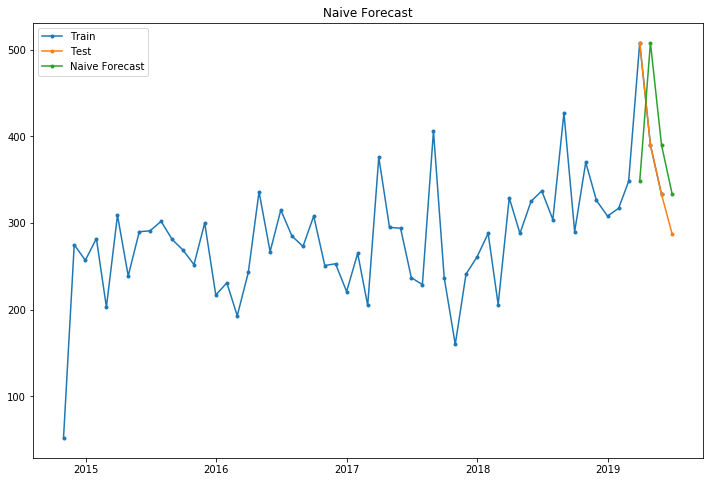

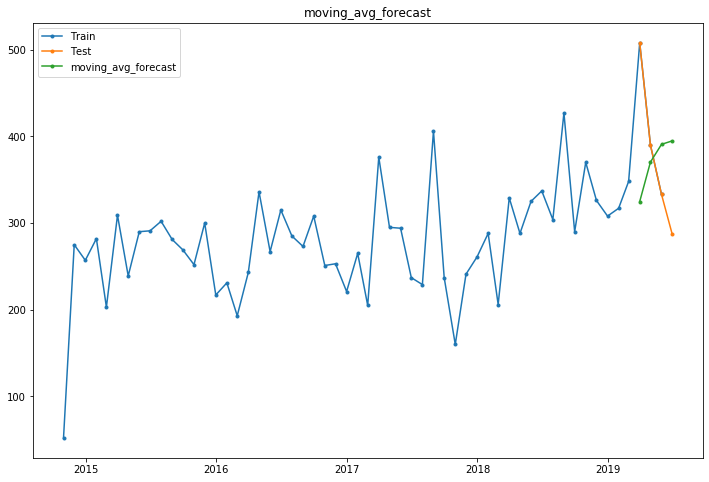

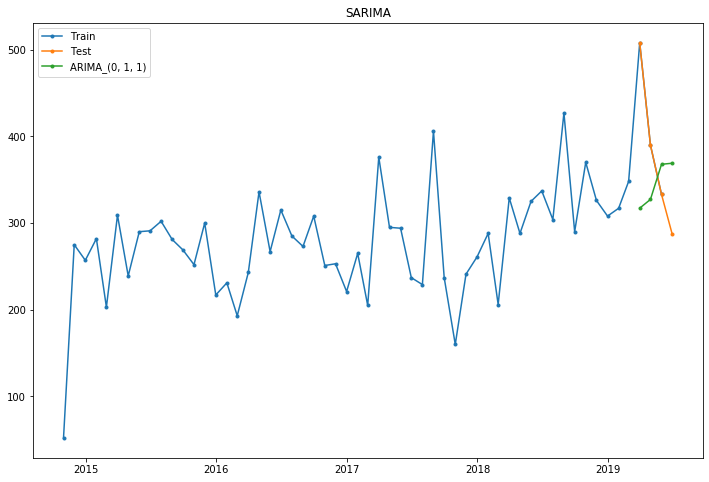

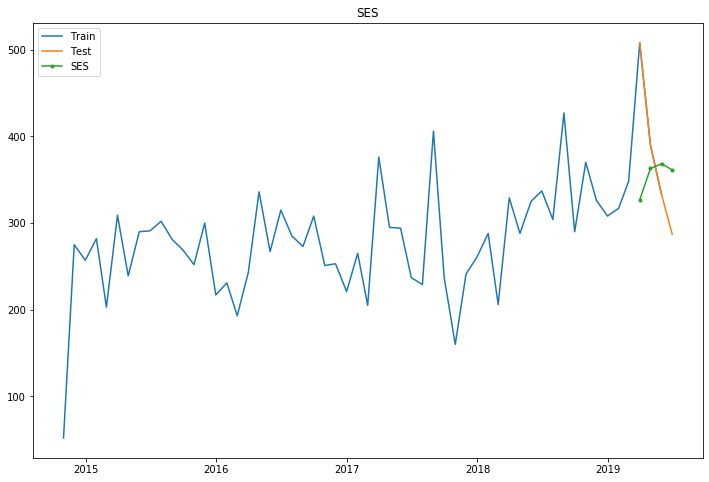

naive : 105.93512165471846
moving_average : 110.58452649444224
arimas : 109.88745367183107
index :  150017509


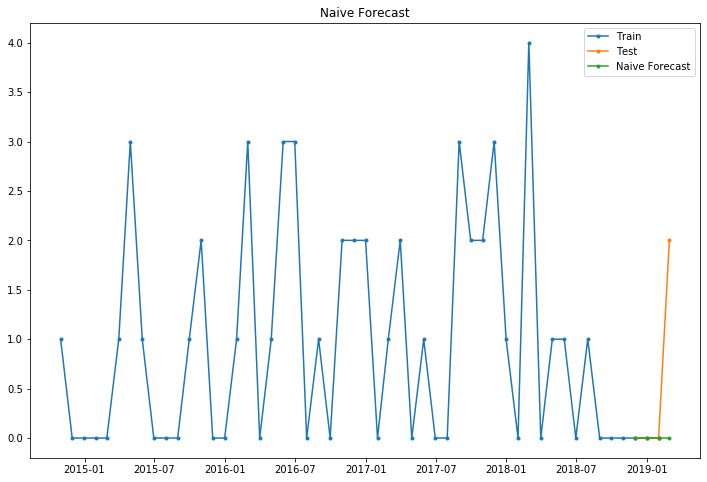

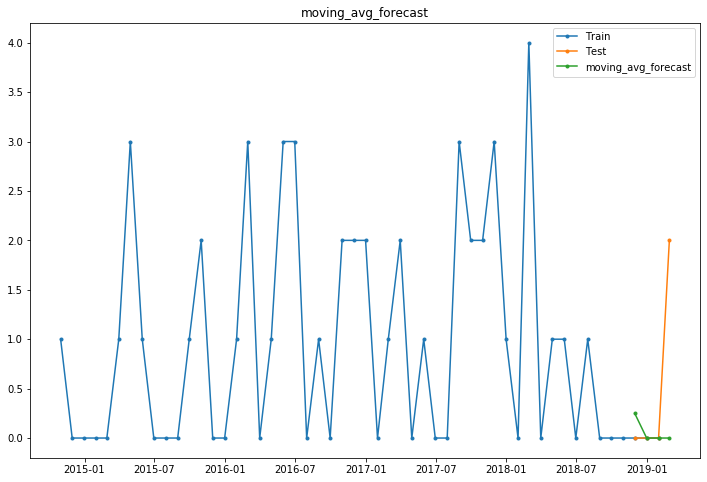

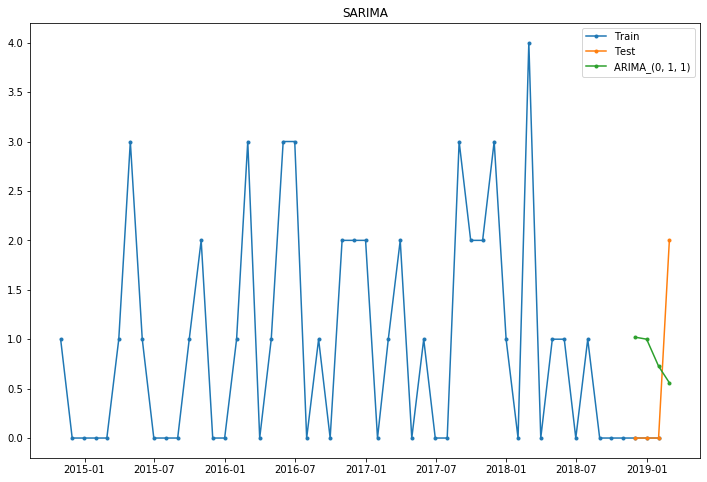

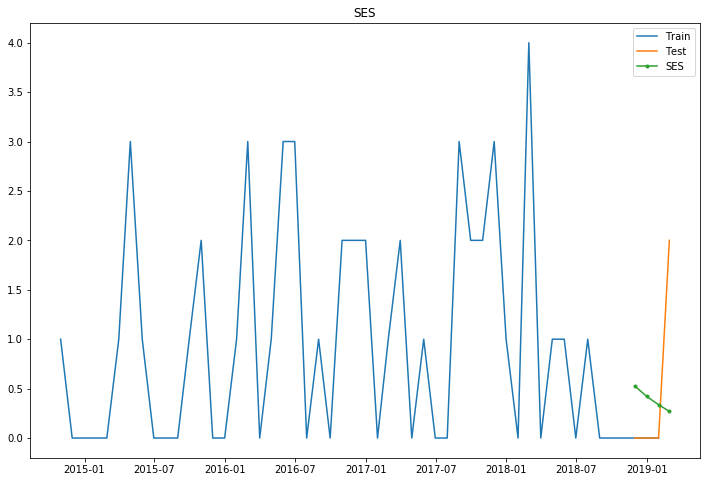

naive : 1.0
moving_average : 1.0077822185373186
arimas : 1.077836168966962
index :  150032545


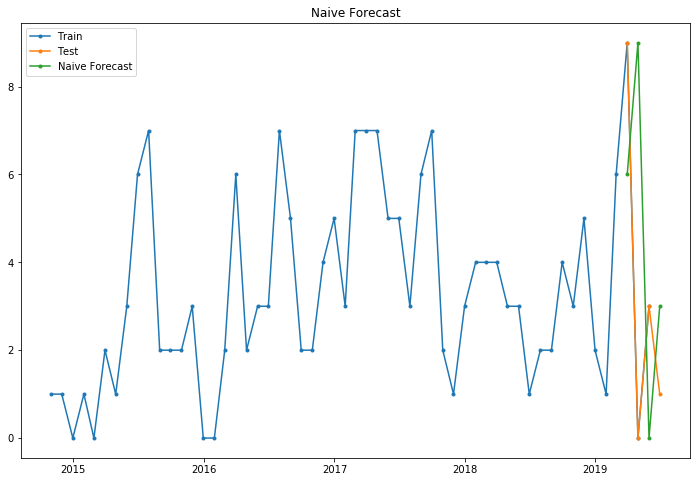

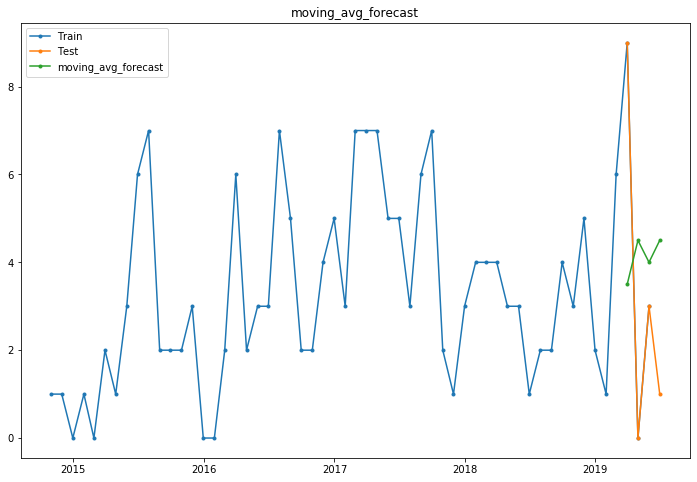

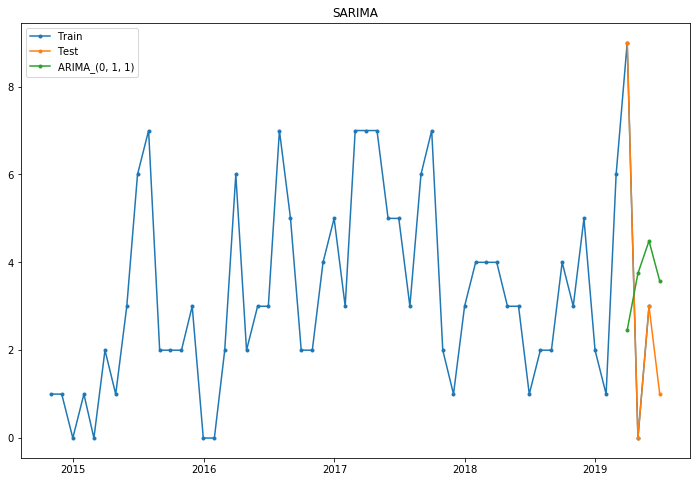

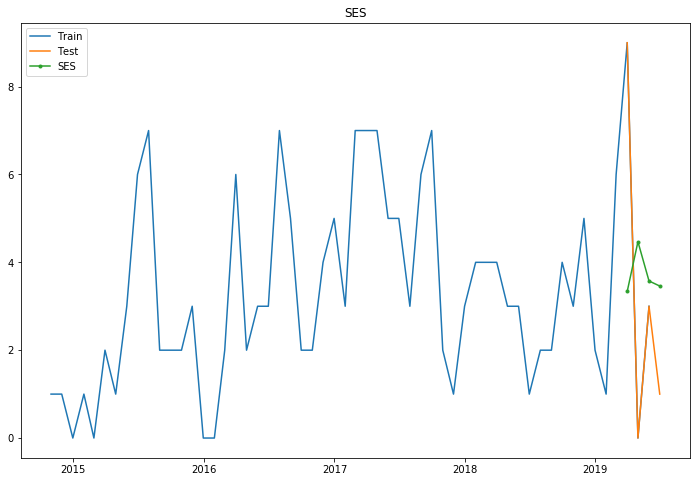

naive : 5.07444578254611
moving_average : 3.992179855667828
arimas : 4.052398749649913
index :  150033644


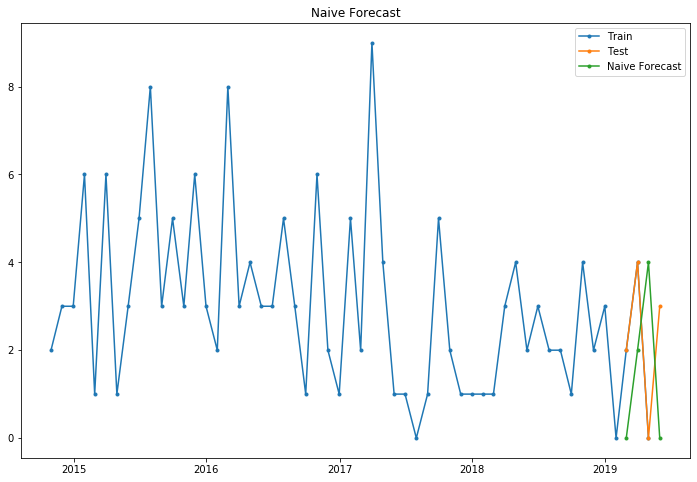

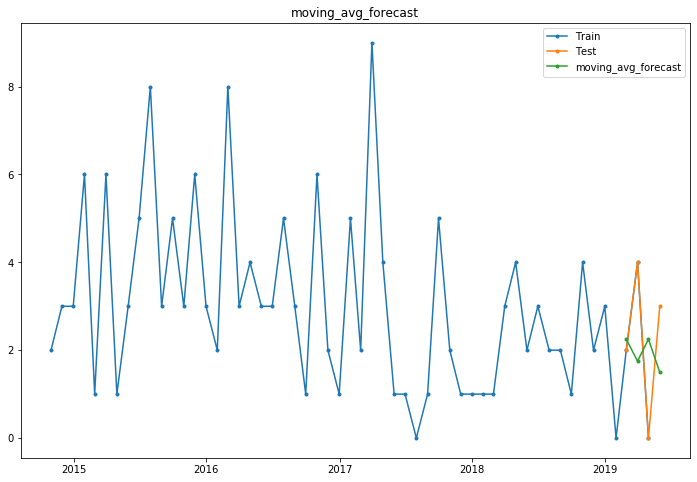

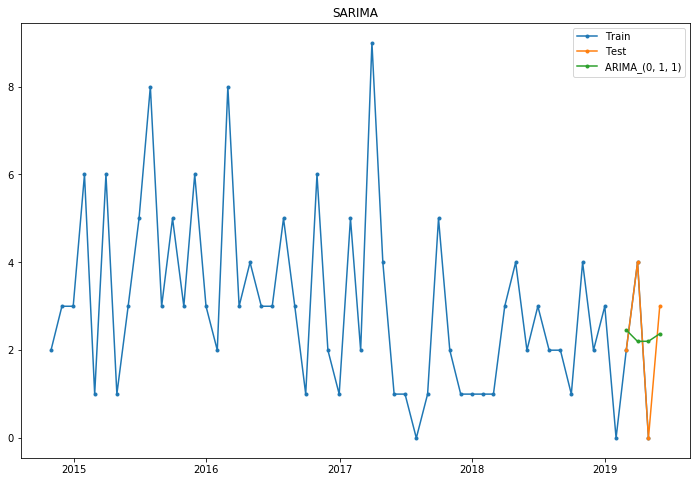

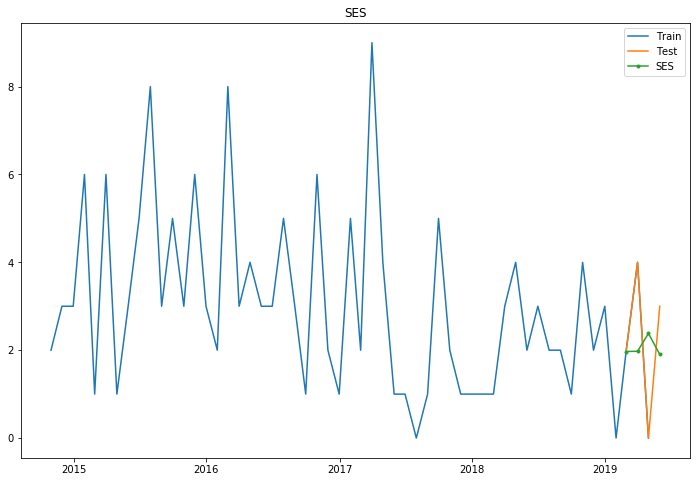

naive : 2.8722813232690143
moving_average : 1.7633419974582356
arimas : 1.4741272740428868
index :  150033199


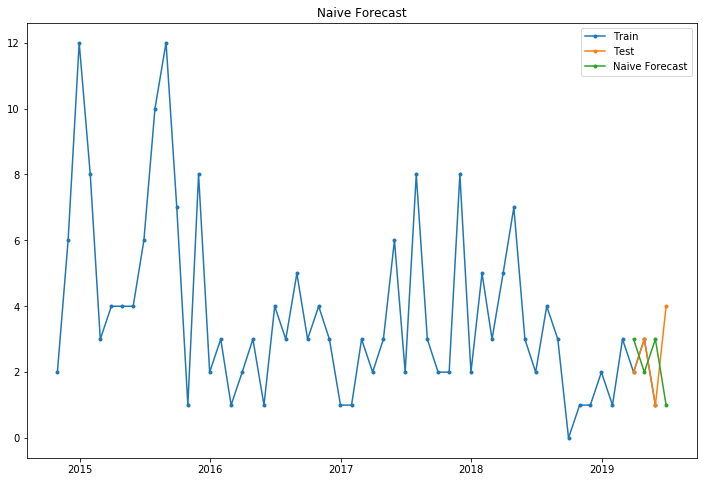

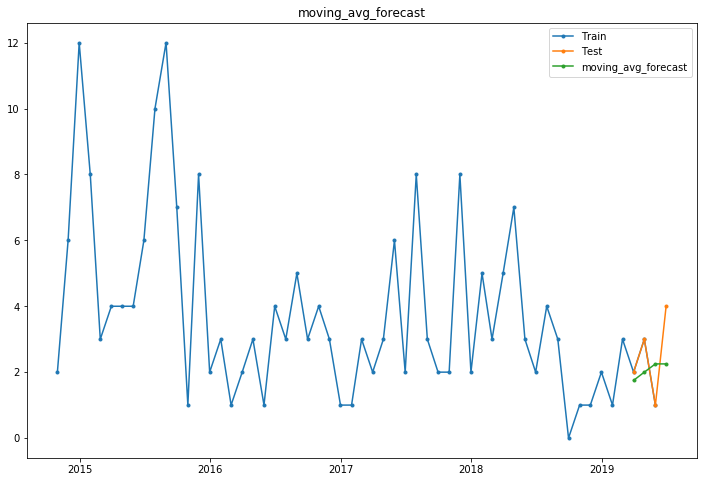

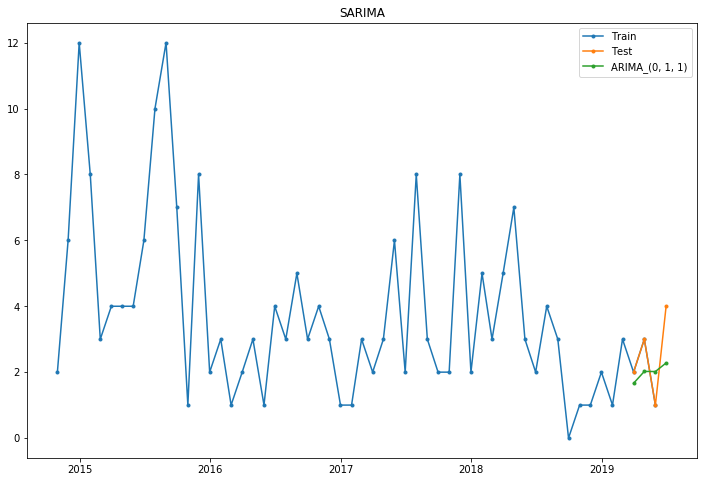

KeyboardInterrupt: 

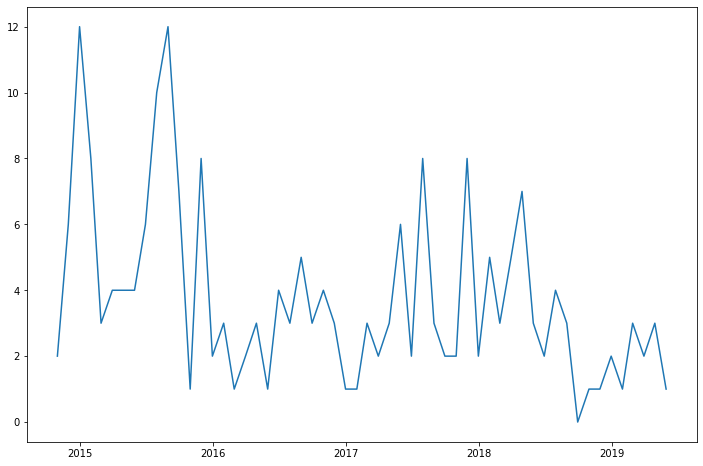

In [249]:
for i in range (0,5):
            matnr = int(grp_mov["MaterialNumber"].iloc[i])
#             print("count",cnt)
            print("index : ",matnr)
            output1,rms1,mae1 = naive(grp_mov,matnr,4)
            output2,rms2,mae2 = moving_average(grp_mov,matnr,4,4)
            output3,rms3,mae3 = sarima(grp_mov,matnr,4,0,1,1)
            output4,rms4,mae4 = ses(grp_mov,matnr,4,0.2)
            print("naive :",rms1)
            print("moving_average :",rms2)
            print("arimas :",rms3)